In [202]:
import xml.etree.ElementTree as Xet
import pandas as pd
import numpy as np
import geopandas as gpd
import os
import matplotlib.pyplot as plt
import warnings
import re

# Ignore all warnings
warnings.filterwarnings('ignore')

# New Jersey 2022 General Election PBER

## Load Election Data

Data from MEDSL, can be downloaded from Github at https://github.com/MEDSL/2022-elections-official/blob/main/individual_states/2022-nj-local-precinct-general.zip

In [203]:
csv_path = './nj22_cleaned.csv'
df = pd.read_csv(csv_path)
# Set pandas options to display all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
# pd.reset_option('display.max_rows')
# pd.reset_option('display.max_columns')
# df = df[~df['precinct'].str.contains(r'court\s*order|federal|total', case=False, regex=True)]
print(df['mode'].unique())


['TOTAL' 'NON-FEDERAL' 'FEDERAL OVERSEAS']


### Important Note(mentioned in the readme)
"In counties where Federal ballots are reported, we label the other modes 'NON-FEDERAL', under the assumption that they contain everything except federal overseas ballots."

It is confusing that some counties have only federal votes and some conties have only non-federal votes. I believe that the description is wrong.

There are also total counts for each candidate for each county, which is not ideal in the PBER(at precinct level). So I am getting rid of rows with total count to ease the process of matching.



In [204]:
# Filter for federal overseas and court order votes for potential allocation
special_modes = df[(df['mode'].isin(['FEDERAL OVERSEAS'])) | (df['precinct'].isin(['federal', 'Court Order']))]

special_modes_sorted = special_modes.sort_values(by='jurisdiction_name')

special_modes_sorted

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude
366,Court Order,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,0,ATLANTIC,34001,ATLANTIC,34001,MICHAEL GALLO,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
392,Court Order,US HOUSE,NOT FOR SALE,OTHER,NON-FEDERAL,0,ATLANTIC,34001,ATLANTIC,34001,ANTHONY PARISI SANCHEZ,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
391,Federal,US HOUSE,NOT FOR SALE,OTHER,FEDERAL OVERSEAS,0,ATLANTIC,34001,ATLANTIC,34001,ANTHONY PARISI SANCHEZ,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
365,Federal,US HOUSE,LIBERTARIAN PARTY,OTHER,FEDERAL OVERSEAS,0,ATLANTIC,34001,ATLANTIC,34001,MICHAEL GALLO,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
340,Court Order,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,1,ATLANTIC,34001,ATLANTIC,34001,TIM ALEXANDER,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
339,Federal,US HOUSE,DEMOCRAT,DEMOCRAT,FEDERAL OVERSEAS,26,ATLANTIC,34001,ATLANTIC,34001,TIM ALEXANDER,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
314,Court Order,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,1,ATLANTIC,34001,ATLANTIC,34001,JEFF VAN DREW,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
313,Federal,US HOUSE,REPUBLICAN,REPUBLICAN,FEDERAL OVERSEAS,2,ATLANTIC,34001,ATLANTIC,34001,JEFF VAN DREW,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
51,Federal Oversea,US HOUSE,DEMOCRAT,DEMOCRAT,FEDERAL OVERSEAS,69,CAMDEN,34007,CAMDEN,34007,DONALD W NORCROSS,1,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1
203,Federal Oversea,US HOUSE,CANNON FIRE,OTHER,FEDERAL OVERSEAS,1,CAMDEN,34007,CAMDEN,34007,ALLEN J CANNON,1,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1


## Process Election Data

In [205]:
# Count unique counties
unique_counties = df['county_name'].nunique()

print(f"Number of unique counties: {unique_counties}")

# Function to clean township names by removing periods, uppercasing, and replacing 'TWP', 'BORO' and 'MT'
def clean_township_name(name):
    name = re.sub(r'\.', '', name.upper())
    name = re.sub(r'\bTWP\b', 'TOWNSHIP', name)
    name = re.sub(r'\bBORO\b', 'BOROUGH', name)
    name = re.sub(r'\bMT\b', 'MOUNT', name)
    name = re.sub(r'\s+', ' ', name).strip()  # Remove extra spaces
    return name
# Since 
# df = df[~df['precinct'].str.contains(r'court\s*order|federal|total', case=False, regex=True)]
df = df[~df['precinct'].str.contains(r'total', case=False, regex=True)]


# Apply the cleaning function to the 'precinct' column
df['precinct'] = df['precinct'].apply(clean_township_name)


# Count unique townships (precincts) in each county
unique_townships_per_county = df.groupby('county_name')['precinct'].nunique()
print("Number of unique townships (precincts) in each county:")
print(unique_townships_per_county)

# Count total number of unique townships
total_unique_townships = df['precinct'].nunique()
print(f"Total number of unique townships (precincts): {total_unique_townships}")



Number of unique counties: 21
Number of unique townships (precincts) in each county:
county_name
ATLANTIC      25
BERGEN        70
BURLINGTON    40
CAMDEN        37
CAPE MAY      17
CUMBERLAND    14
ESSEX         28
GLOUCESTER    25
HUDSON        13
HUNTERDON     26
MERCER        13
MIDDLESEX     26
MONMOUTH      53
MORRIS        40
OCEAN         36
PASSAIC       16
SALEM         15
SOMERSET      21
SUSSEX        26
UNION         21
WARREN        22
Name: precinct, dtype: int64
Total number of unique townships (precincts): 562


## Load in shapefiles

In [206]:
shapefile_path = './Election_Districts_for_New_Jersey_6817419016865430381/Govt_admin_election_district.shp'
gdf_2022 = gpd.read_file(shapefile_path)

gdf_2022['MUN_NAME'] = gdf_2022['MUN_NAME'].str.upper()
gdf_2022['COUNTY'] = gdf_2022['COUNTY'].str.upper()

# Count unique counties
unique_counties = gdf_2022['COUNTY'].nunique()
print(f"Number of unique counties: {unique_counties}")

# Count unique townships in each county
unique_townships_per_county = gdf_2022.groupby('COUNTY')['MUN_NAME'].nunique()
print("Number of unique townships in each county:")
print(unique_townships_per_county)

# Count total number of unique townships
total_unique_townships = gdf_2022['MUN_NAME'].nunique()
print(f"Total number of unique townships: {total_unique_townships}")

Number of unique counties: 21
Number of unique townships in each county:
COUNTY
ATLANTIC      23
BERGEN        70
BURLINGTON    40
CAMDEN        37
CAPE MAY      16
CUMBERLAND    14
ESSEX         22
GLOUCESTER    24
HUDSON        12
HUNTERDON     26
MERCER        12
MIDDLESEX     25
MONMOUTH      53
MORRIS        39
OCEAN         33
PASSAIC       16
SALEM         15
SOMERSET      21
SUSSEX        24
UNION         21
WARREN        22
Name: MUN_NAME, dtype: int64
Total number of unique townships: 547


### Mismatch exists, try using string similarity algorithm(Levenshtein distance from fuzzywuzzy library)

In [207]:
# import geopandas as gpd
# import pandas as pd
# from fuzzywuzzy import process
# import re

# # Function to clean township names
# def clean_township_name(name):
#     return re.sub(r'\b(BOROUGH|CITY|TWP|TOWN|VILLAGE|MUNICIPALITY|TOWNSHIP|BORO)\b', '', name, flags=re.IGNORECASE).strip()

# # Normalize county and township names to uppercase for comparison
# gdf_2022['COUNTY'] = gdf_2022['COUNTY'].str.upper()
# gdf_2022['MUN_NAME'] = gdf_2022['MUN_NAME'].apply(lambda x: clean_township_name(x.upper()))
# df['county_name'] = df['county_name'].str.upper()
# df['precinct'] = df['precinct'].apply(lambda x: clean_township_name(x.upper()))

# # Make sure the county names match
# counties_gdf = set(gdf_2022['COUNTY'].unique())
# counties_df = set(df['county_name'].unique())

# mismatched_counties_gdf = counties_gdf - counties_df
# mismatched_counties_df = counties_df - counties_gdf

# if mismatched_counties_gdf:
#     print("Counties only in shapefile:", mismatched_counties_gdf)
# if mismatched_counties_df:
#     print("Counties only in df:", mismatched_counties_df)

# # Proceed only with matched counties
# matched_counties = counties_gdf & counties_df

# # Get all unique township names from both datasets within matched counties
# for county in matched_counties:
#     townships_gdf = set(gdf_2022[gdf_2022['COUNTY'] == county]['MUN_NAME'].unique())
#     townships_df = set(df[df['county_name'] == county]['precinct'].unique())

#     # Create a mapping using fuzzy matching for the remaining names
#     township_name_mapping = {}
#     for township in townships_gdf:
#         match, score = process.extractOne(township, townships_df)
#         if score > 80:
#             township_name_mapping[township] = match

#     # Apply the fuzzy mapping to the shapefile township names
#     gdf_2022['MUN_NAME'] = gdf_2022['MUN_NAME'].apply(lambda x: township_name_mapping.get(x, x))

#     # Re-evaluate unique townships after applying fuzzy matching
#     townships_gdf = set(gdf_2022[gdf_2022['COUNTY'] == county]['MUN_NAME'].unique())
#     townships_df = set(df[df['county_name'] == county]['precinct'].unique())

#     # Find differences
#     only_in_gdf = townships_gdf - townships_df
#     only_in_df = townships_df - townships_gdf

#     if only_in_gdf or only_in_df:
#         print(f"Differences in county: {county}")
#         if only_in_gdf:
#             print(f"  Townships only in shapefile: {only_in_gdf}")
#         if only_in_df:
#             print(f"  Townships only in df: {only_in_df}")

### However, there are still mistaches, and the alogorithm is not smart enough. So, do some manual checking county by county

### Function to allocate court order and federal overseas votes

In [208]:
def allocate_votes(df, county_name, candidate_name, allocate_votes):
    # Filter precincts in the specified county that voted for the specified candidate
    relevant_precincts = df[(df['county_name'] == county_name) & (df['candidate'] == candidate_name)]
    
    # Remove precincts that contain 'court order', 'federal', or 'total' in their names
    relevant_precincts = relevant_precincts[~relevant_precincts['precinct'].str.contains(r'court\s*order|federal|total', case=False, regex=True)]
    
    # Calculate the total number of votes for the candidate in relevant precincts
    total_votes_candidate = relevant_precincts['votes'].sum()
    
    # Calculate the proportion of votes for each precinct
    relevant_precincts['vote_proportion'] = relevant_precincts['votes'] / total_votes_candidate
    
    # Allocate the federal overseas votes proportionally
    relevant_precincts['allocated_federal_overseas_votes'] = relevant_precincts['vote_proportion'] * allocate_votes
    
    # Ensure the allocated votes are numeric and handle NaN values
    relevant_precincts['allocated_federal_overseas_votes'] = relevant_precincts['allocated_federal_overseas_votes'].fillna(0).astype(int)

    # Round allocated votes to the nearest integer to maintain whole vote counts
    relevant_precincts['allocated_federal_overseas_votes'] = relevant_precincts['allocated_federal_overseas_votes'].round()
    
    # Add the allocated federal overseas votes to the original votes
    relevant_precincts['votes'] += relevant_precincts['allocated_federal_overseas_votes']
    
    # Update the main DataFrame with the new total votes
    df.update(relevant_precincts[['precinct', 'votes']])

### Function to join election results with precinct boundaries

In [268]:
# def clean_township_name(name):
#     name = re.sub(r'\.', '', name.upper())
#     name = re.sub(r'\b(TWP|TOWN|TOWNSHIP|BORO|BOROUGH|VILLAGE)\b', '', name)
#     name = re.sub(r'\bCITY\b$', '', name)  # Remove CITY only if it's the last word
#     name = re.sub(r'\s+', ' ', name).strip()  # Remove extra spaces
#     return name

# def clean_geometries(gdf):
#     """Clean geometries in a GeoDataFrame."""
#     gdf = gdf.copy()
#     gdf['geometry'] = gdf['geometry'].buffer(0)
#     return gdf

# # Function to process each county
# def process_county(county_name, df, gdf, manual_mapping=None):
#     df_county = df[df['county_name'] == county_name.upper()]
#     gdf_county = gdf[gdf['COUNTY'] == county_name.upper()]

#     df_county = df_county[~df['precinct'].str.contains(r'court\s*order|federal|total', case=False, regex=True)]


#     gdf_county['MUN_NAME'] = gdf_county['MUN_NAME'].apply(clean_township_name)
#     df_county['precinct'] = df_county['precinct'].apply(clean_township_name)

#     if manual_mapping:
#         # Apply the manual mapping to df_county
#         df_county['precinct_mapped'] = df_county['precinct'].replace(manual_mapping)
#         merge_on_left = 'precinct_mapped'
#     else:
#         merge_on_left = 'precinct'
    
#     if manual_mapping:
#         print(sorted(df_county['precinct_mapped'].unique()))
#     else:
#         print(sorted(df_county['precinct'].unique()))

#     print(sorted(gdf_county['MUN_NAME'].unique()))


#     # Select only the geometry column and 'MUN_NAME_CLEANED' from the GeoDataFrame
#     gdf_county = gdf_county[['MUN_NAME', 'geometry']]

#     gdf_county = clean_geometries(gdf_county)

#     # Merge the DataFrame and GeoDataFrame on the appropriate columns
#     merged_county = pd.merge(df_county, gdf_county, left_on=merge_on_left, right_on='MUN_NAME', how='right')

#     # Drop the columns used for merging
#     if manual_mapping:
#         merged_county = merged_county.drop(columns=['MUN_NAME'])
#     else:
#         merged_county = merged_county.drop(columns=['MUN_NAME'])

#     # Convert the merged DataFrame to a GeoDataFrame
#     merged_gdf = gpd.GeoDataFrame(merged_county, geometry='geometry')

#     # Dissolve the GeoDataFrame by precinct to aggregate geometries
#     aggregated_gdf = merged_gdf.dissolve(by='precinct', as_index=False)

#     # Create a larger plot
#     fig, ax = plt.subplots(figsize=(40, 40))

#     # Plot the geometries for the county with improved borders
#     aggregated_gdf.plot(column='precinct', ax=ax, legend=True, cmap='tab20', edgecolor='black', linewidth=0.5)

#     # Add labels to each precinct based on manual_mapping flag
#     if manual_mapping:
#         for x, y, label in zip(aggregated_gdf.geometry.centroid.x, aggregated_gdf.geometry.centroid.y, aggregated_gdf['precinct_mapped']):
#             ax.text(x, y, label, fontsize=15, ha='center')  # Adjust font size as needed
#     else:
#         for x, y, label in zip(aggregated_gdf.geometry.centroid.x, aggregated_gdf.geometry.centroid.y, aggregated_gdf['precinct']):
#             ax.text(x, y, label, fontsize=15, ha='center')  # Adjust font size as needed


#     plt.show()

#     return merged_gdf

import re
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

def clean_township_name(name):
    name = re.sub(r'\.', '', name.upper())
    name = re.sub(r'\b(TWP|TOWN|TOWNSHIP|BORO|BOROUGH|VILLAGE)\b', '', name)
    name = re.sub(r'\bCITY\b$', '', name)  # Remove CITY only if it's the last word
    name = re.sub(r'\s+', ' ', name).strip()  # Remove extra spaces
    return name

def clean_geometries(gdf):
    """Clean geometries in a GeoDataFrame."""
    gdf = gdf.copy()
    gdf['geometry'] = gdf['geometry'].buffer(0)
    gdf = gdf[gdf.is_valid]
    return gdf

# Function to process each county
def process_county(county_name, df, gdf, manual_mapping=None):
    df_county = df[df['county_name'] == county_name.upper()]
    gdf_county = gdf[gdf['COUNTY'] == county_name.upper()]

    df_county = df_county[~df_county['precinct'].str.contains(r'court\s*order|federal|total', case=False, regex=True)]

    gdf_county['MUN_NAME'] = gdf_county['MUN_NAME'].apply(clean_township_name)
    df_county['precinct'] = df_county['precinct'].apply(clean_township_name)

    if manual_mapping:
        # Apply the manual mapping to df_county
        df_county['precinct_mapped'] = df_county['precinct'].replace(manual_mapping)
    else:
        # If manual_mapping is not provided, copy precinct to precinct_mapped
        df_county['precinct_mapped'] = df_county['precinct']

    # Ensure all precincts have a mapping
    if manual_mapping:
        missing_precincts = df_county['precinct'][~df_county['precinct'].isin(manual_mapping.keys())].unique()
        print("Missing mappings for the following precincts:", missing_precincts)

    # Determine the column to merge on
    merge_on_left = 'precinct_mapped'

    if manual_mapping:
        print(sorted(df_county['precinct_mapped'].unique()))
    else:
        print(sorted(df_county['precinct'].unique()))

    print(sorted(gdf_county['MUN_NAME'].unique()))

    # Select only the geometry column and 'MUN_NAME_CLEANED' from the GeoDataFrame
    gdf_county = gdf_county[['MUN_NAME', 'geometry']]

    gdf_county = clean_geometries(gdf_county)

    # Merge the DataFrame and GeoDataFrame on the appropriate columns
    merged_county = pd.merge(df_county, gdf_county, left_on=merge_on_left, right_on='MUN_NAME', how='right')

    # Check for missing geometries after merge
    missing_geometries = merged_county[merged_county['geometry'].isnull()]
    if not missing_geometries.empty:
        print("Missing geometries for the following precincts after merge:")
        print(missing_geometries[['precinct_mapped', 'precinct']])

    # Drop the columns used for merging
    merged_county = merged_county.drop(columns=['MUN_NAME'])

    # Convert the merged DataFrame to a GeoDataFrame
    merged_gdf = gpd.GeoDataFrame(merged_county, geometry='geometry')

    # Dissolve the GeoDataFrame by precinct to aggregate geometries
    aggregated_gdf = merged_gdf.dissolve(by='precinct', as_index=False)

    # Ensure geometries are valid after dissolving
    aggregated_gdf = clean_geometries(aggregated_gdf)

    # Create a larger plot
    fig, ax = plt.subplots(figsize=(40, 40))

    # Plot the geometries for the county with improved borders
    aggregated_gdf.plot(column='precinct', ax=ax, legend=True, cmap='tab20', edgecolor='black', linewidth=0.5)

    # Add labels to each precinct based on manual_mapping flag
    for x, y, label in zip(aggregated_gdf.geometry.centroid.x, aggregated_gdf.geometry.centroid.y, aggregated_gdf['precinct_mapped']):
        ax.text(x, y, label, fontsize=15, ha='center')  # Adjust font size as needed

    plt.show()

    return merged_gdf




#### Atlantic County

In [210]:
allocate_votes(df, 'ATLANTIC', 'TIM ALEXANDER', 27)
allocate_votes(df, 'ATLANTIC', 'JEFF VAN DREW', 3)

['ABSECON', 'ATLANTIC', 'BRIGANTINE', 'BUENA', 'BUENA VISTA', 'CORBIN', 'EGG HARBOR', 'ESTELL MANOR', 'FOLSOM', 'GALLOWAY', 'HAMILTON', 'HAMMONTON', 'LINWOOD', 'LONGPORT', 'MARGATE', 'MULLICA', 'NORTHFIELD', 'PLEASANTVILLE', 'PORT REPUBLIC', 'SOMERS POINT', 'VENTNOR', 'WEYMOUTH']
['ABSECON', 'ATLANTIC', 'BRIGANTINE', 'BUENA', 'BUENA VISTA', 'CORBIN', 'EGG HARBOR', 'ESTELL MANOR', 'FOLSOM', 'GALLOWAY', 'HAMILTON', 'HAMMONTON', 'LINWOOD', 'LONGPORT', 'MARGATE', 'MULLICA', 'NORTHFIELD', 'PLEASANTVILLE', 'PORT REPUBLIC', 'SOMERS POINT', 'VENTNOR', 'WEYMOUTH']


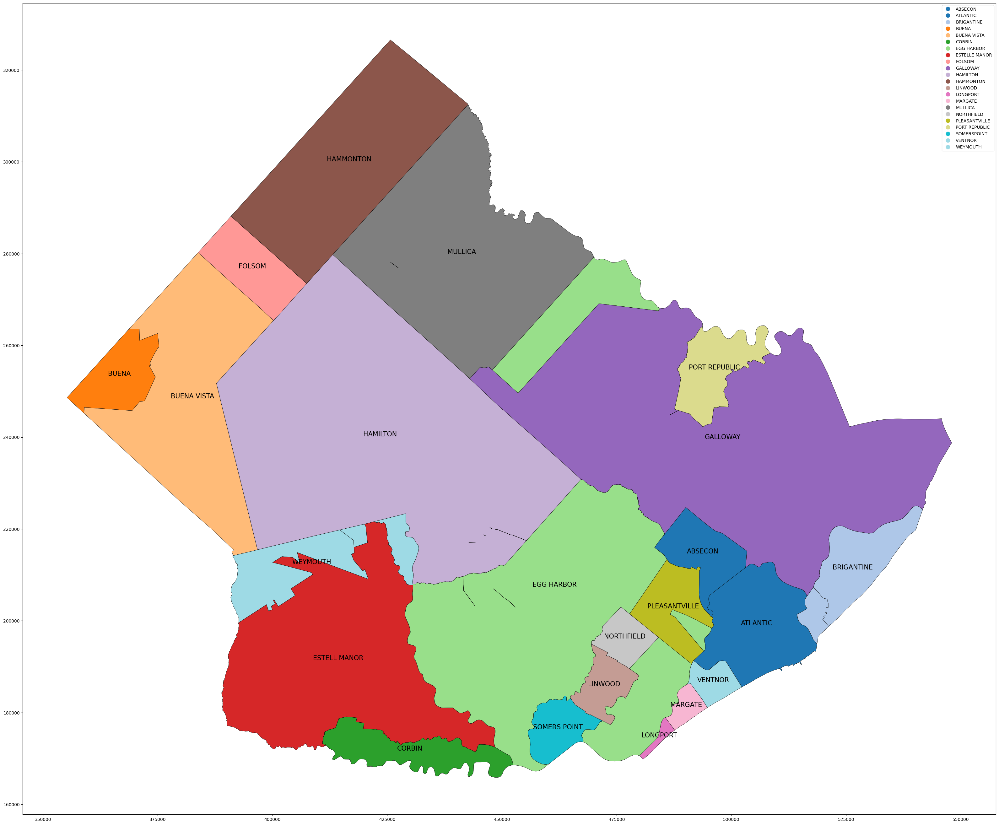

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,MULLICA,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,1287,ATLANTIC,34001,ATLANTIC,34001,JEFF VAN DREW,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,MULLICA,"POLYGON ((427942.516 266334.807, 426253.899 26..."
1,MULLICA,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,677,ATLANTIC,34001,ATLANTIC,34001,TIM ALEXANDER,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,MULLICA,"POLYGON ((427942.516 266334.807, 426253.899 26..."
2,MULLICA,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,18,ATLANTIC,34001,ATLANTIC,34001,MICHAEL GALLO,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,MULLICA,"POLYGON ((427942.516 266334.807, 426253.899 26..."
3,MULLICA,US HOUSE,NOT FOR SALE,OTHER,NON-FEDERAL,4,ATLANTIC,34001,ATLANTIC,34001,ANTHONY PARISI SANCHEZ,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,MULLICA,"POLYGON ((427942.516 266334.807, 426253.899 26..."
4,BUENA VISTA,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,1454,ATLANTIC,34001,ATLANTIC,34001,JEFF VAN DREW,2,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BUENA VISTA,"POLYGON ((376628.927 228978.235, 374730.032 23..."


In [211]:
manual_mapping = {
    'ESTELLE MANOR': 'ESTELL MANOR',
    'SOMERSPOINT': 'SOMERS POINT',
}
atlantic_processed = process_county('ATLANTIC', df, gdf_2022, manual_mapping)
atlantic_processed.head(5)

#### Bergen County

['ALLENDALE', 'ALPINE', 'BERGENFIELD', 'BOGOTA', 'CARLSTADT', 'CLIFFSIDE PARK', 'CLOSTER', 'CRESSKILL', 'DEMAREST', 'DUMONT', 'EAST RUTHERFORD', 'EDGEWATER', 'ELMWOOD PARK', 'EMERSON', 'ENGLEWOOD', 'ENGLEWOOD CLIFFS', 'FAIR LAWN', 'FAIRVIEW', 'FORT LEE', 'FRANKLIN LAKES', 'GARFIELD', 'GLEN ROCK', 'HACKENSACK', 'HARRINGTON PARK', 'HASBROUCK HEIGHTS', 'HAWORTH', 'HILLSDALE', 'HO-HO-KUS', 'LEONIA', 'LITTLE FERRY', 'LODI', 'LYNDHURST', 'MAHWAH', 'MAYWOOD', 'MIDLAND PARK', 'MONTVALE', 'MOONACHIE', 'NEW MILFORD', 'NORTH ARLINGTON', 'NORTHVALE', 'NORWOOD', 'OAKLAND', 'OLD TAPPAN', 'ORADELL', 'PALISADES PARK', 'PARAMUS', 'PARK RIDGE', 'RAMSEY', 'RIDGEFIELD', 'RIDGEFIELD PARK', 'RIDGEWOOD', 'RIVER EDGE', 'RIVER VALE', 'ROCHELLE PARK', 'ROCKLEIGH', 'RUTHERFORD', 'SADDLE BROOK', 'SADDLE RIVER', 'SOUTH HACKENSACK', 'TEANECK', 'TENAFLY', 'TETERBORO', 'UPPER SADDLE RIVER', 'WALDWICK', 'WALLINGTON', 'WASHINGTON', 'WESTWOOD', 'WOOD-RIDGE', 'WOODCLIFF LAKE', 'WYCKOFF']
['ALLENDALE', 'ALPINE', 'BERGENFI

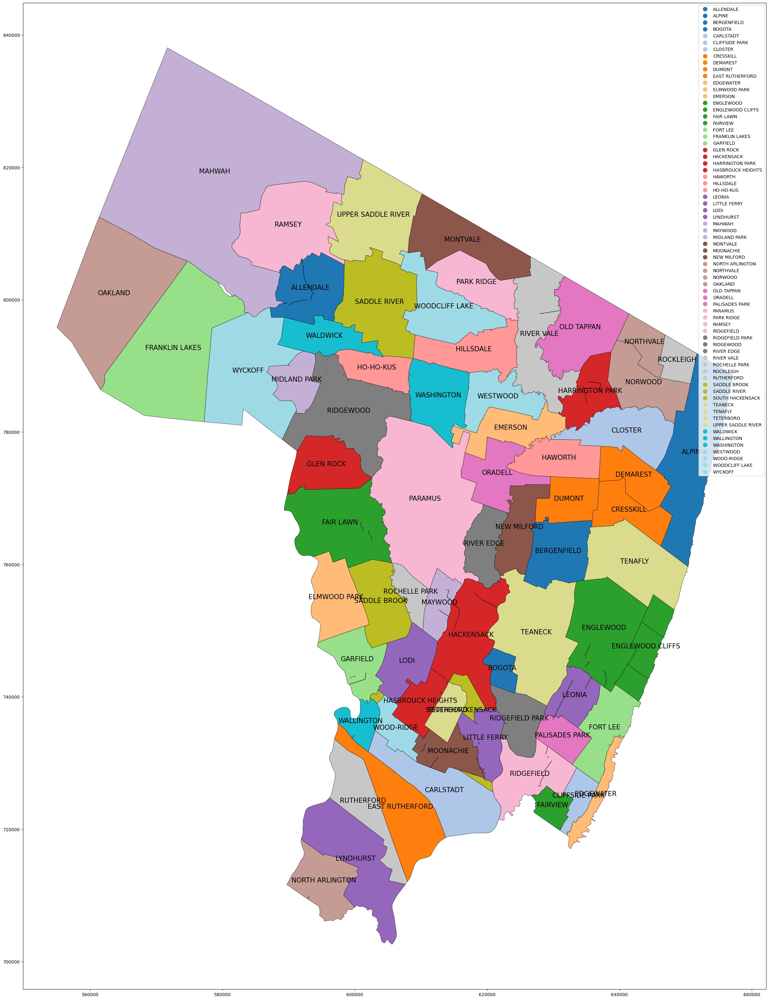

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,NORTH ARLINGTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,1900,BERGEN,34003,BERGEN,34003,BILL PASCRELL JR,9,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,NORTH ARLINGTON,"POLYGON ((598160.441 712301.785, 599038.851 71..."
1,NORTH ARLINGTON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,2436,BERGEN,34003,BERGEN,34003,BILLY PREMPEH,9,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,NORTH ARLINGTON,"POLYGON ((598160.441 712301.785, 599038.851 71..."
2,NORTH ARLINGTON,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,28,BERGEN,34003,BERGEN,34003,SEAN ARMSTRONG,9,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,NORTH ARLINGTON,"POLYGON ((598160.441 712301.785, 599038.851 71..."
3,NORTH ARLINGTON,US HOUSE,SOCIALIST WORKERS,OTHER,TOTAL,21,BERGEN,34003,BERGEN,34003,LEA SHERMAN,9,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,NORTH ARLINGTON,"POLYGON ((598160.441 712301.785, 599038.851 71..."
4,NORTH ARLINGTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,1900,BERGEN,34003,BERGEN,34003,BILL PASCRELL JR,9,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,NORTH ARLINGTON,"POLYGON ((590336.635 712799.354, 590414.870 71..."


In [212]:
bergen_processed = process_county('BERGEN', df, gdf_2022)
bergen_processed.head(5)

### BURLINGTON COUNTY

['BASS RIVER', 'BEVERLY', 'BORDENTOWN', 'BURLINGTON', 'CHESTERFIELD', 'CINNAMINSON', 'DELANCO', 'DELRAN', 'EASTAMPTON', 'EDGEWATER PARK', 'EVESHAM', 'FIELDSBORO', 'FLORENCE', 'HAINESPORT', 'LUMBERTON', 'MANSFIELD', 'MAPLE SHADE', 'MEDFORD', 'MEDFORD LAKES', 'MOORESTOWN', 'MOUNT HOLLY', 'MOUNT LAUREL', 'NEW HANOVER', 'NORTH HANOVER', 'PALMYRA', 'PEMBERTON', 'RIVERSIDE', 'RIVERTON', 'SHAMONG', 'SOUTHAMPTON', 'SPRINGFIELD', 'TABERNACLE', 'WASHINGTON', 'WESTAMPTON', 'WILLINGBORO', 'WOODLAND', 'WRIGHTSTOWN']
['BASS RIVER', 'BEVERLY', 'BORDENTOWN', 'BURLINGTON', 'CHESTERFIELD', 'CINNAMINSON', 'DELANCO', 'DELRAN', 'EASTAMPTON', 'EDGEWATER PARK', 'EVESHAM', 'FIELDSBORO', 'FLORENCE', 'HAINESPORT', 'LUMBERTON', 'MANSFIELD', 'MAPLE SHADE', 'MEDFORD', 'MEDFORD LAKES', 'MOORESTOWN', 'MOUNT HOLLY', 'MOUNT LAUREL', 'NEW HANOVER', 'NORTH HANOVER', 'PALMYRA', 'PEMBERTON', 'RIVERSIDE', 'RIVERTON', 'SHAMONG', 'SOUTHAMPTON', 'SPRINGFIELD', 'TABERNACLE', 'WASHINGTON', 'WESTAMPTON', 'WILLINGBORO', 'WOODLAND

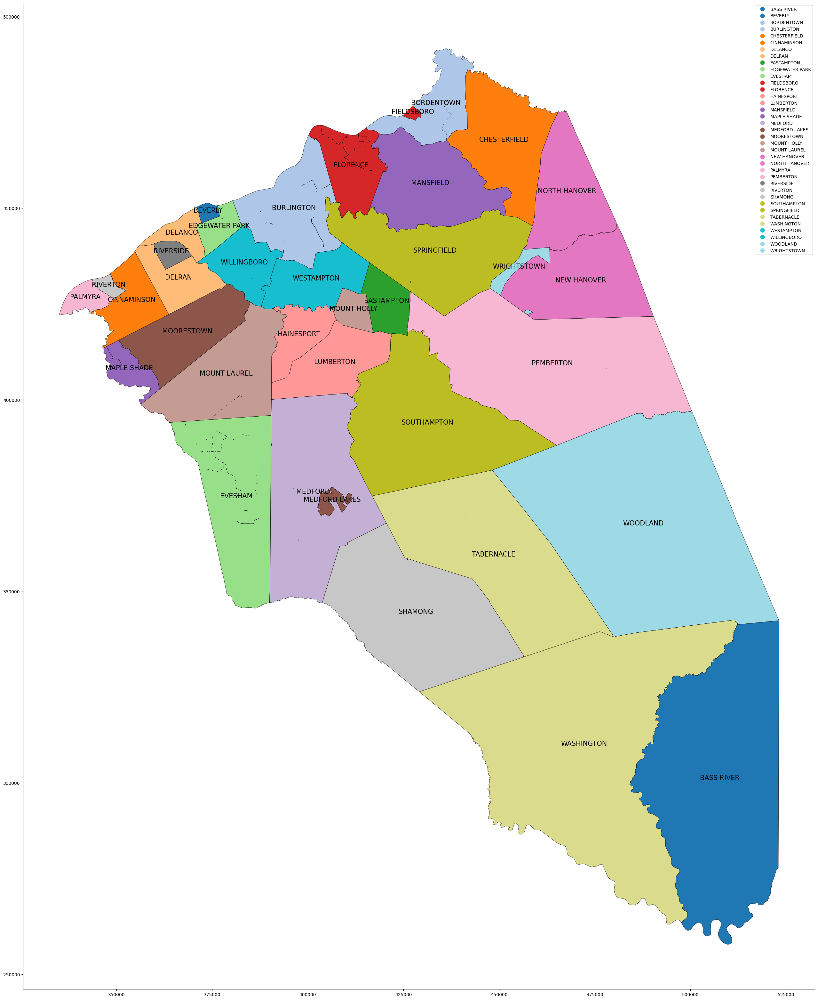

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,BORDENTOWN,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,1177,BURLINGTON,34005,BURLINGTON,34005,ANDY KIM,3,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BORDENTOWN,"POLYGON ((436626.690 491361.780, 436701.190 49..."
1,BORDENTOWN,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,2449,BURLINGTON,34005,BURLINGTON,34005,ANDY KIM,3,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BORDENTOWN,"POLYGON ((436626.690 491361.780, 436701.190 49..."
2,BORDENTOWN,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,479,BURLINGTON,34005,BURLINGTON,34005,BOB HEALEY,3,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BORDENTOWN,"POLYGON ((436626.690 491361.780, 436701.190 49..."
3,BORDENTOWN,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,1762,BURLINGTON,34005,BURLINGTON,34005,BOB HEALEY,3,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BORDENTOWN,"POLYGON ((436626.690 491361.780, 436701.190 49..."
4,BORDENTOWN,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,9,BURLINGTON,34005,BURLINGTON,34005,CHRISTOPHER RUSSOMANNO,3,HOUSE,2022,GEN,NEW JERSEY,False,False,NJ,34,22,12,2022-11-08,True,1,BORDENTOWN,"POLYGON ((436626.690 491361.780, 436701.190 49..."


In [213]:
burlington_processed = process_county('BURLINGTON', df, gdf_2022)
burlington_processed.head(5)

### CAMDEN COUNTY

In [214]:
# Define the new row with precinct "PINE VALLEY"
new_row = pd.DataFrame({'county_name': ['CAMDEN'], 'precinct': ['PINE VALLEY'], 'candidate': [None], 'votes': [None], 'mode': [None]})

# Append the new row to the DataFrame
df = pd.concat([df, new_row], ignore_index=True)

['AUDUBON', 'AUDUBON PARK', 'BARRINGTON', 'BELLMAWR', 'BERLIN', 'BROOKLAWN', 'CAMDEN', 'CHERRY HILL', 'CHESILHURST', 'CLEMENTON', 'COLLINGSWOOD', 'GIBBSBORO', 'GLOUCESTER', 'HADDON', 'HADDON HEIGHTS', 'HADDONFIELD', 'HI-NELLA', 'LAUREL SPRINGS', 'LAWNSIDE', 'LINDENWOLD', 'MAGNOLIA', 'MERCHANTVILLE', 'MOUNT EPHRAIM', 'OAKLYN', 'PENNSAUKEN', 'PINE HILL', 'PINE VALLEY', 'RUNNEMEDE', 'SOMERDALE', 'STRATFORD', 'TAVISTOCK', 'VOORHEES', 'WATERFORD', 'WINSLOW', 'WOODLYNNE']
['AUDUBON', 'AUDUBON PARK', 'BARRINGTON', 'BELLMAWR', 'BERLIN', 'BROOKLAWN', 'CAMDEN', 'CHERRY HILL', 'CHESILHURST', 'CLEMENTON', 'COLLINGSWOOD', 'GIBBSBORO', 'GLOUCESTER', 'HADDON', 'HADDON HEIGHTS', 'HADDONFIELD', 'HI-NELLA', 'LAUREL SPRINGS', 'LAWNSIDE', 'LINDENWOLD', 'MAGNOLIA', 'MERCHANTVILLE', 'MOUNT EPHRAIM', 'OAKLYN', 'PENNSAUKEN', 'PINE HILL', 'PINE VALLEY', 'RUNNEMEDE', 'SOMERDALE', 'STRATFORD', 'TAVISTOCK', 'VOORHEES', 'WATERFORD', 'WINSLOW', 'WOODLYNNE']


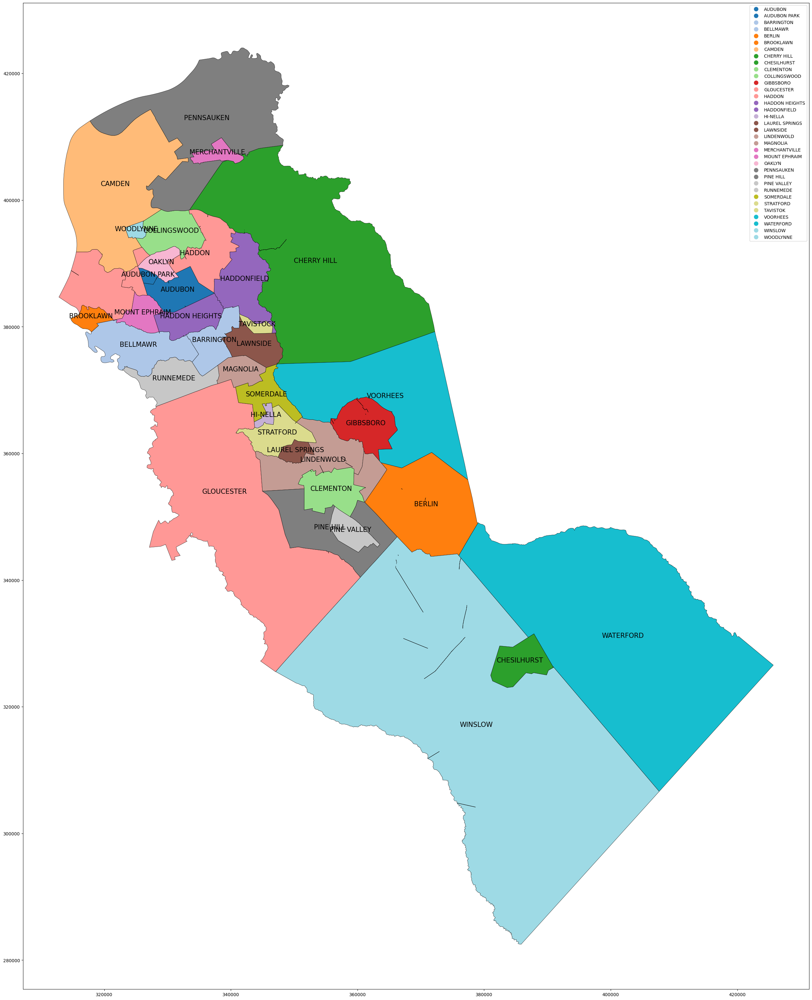

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,CLEMENTON,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,750,CAMDEN,34007.0,CAMDEN,34007.0,DONALD W NORCROSS,1.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLEMENTON,"POLYGON ((353309.570 357248.080, 353316.521 35..."
1,CLEMENTON,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,370,CAMDEN,34007.0,CAMDEN,34007.0,CLAIRE GUSTAFSON,1.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLEMENTON,"POLYGON ((353309.570 357248.080, 353316.521 35..."
2,CLEMENTON,US HOUSE,FOR THE PEOPLE,OTHER,NON-FEDERAL,23,CAMDEN,34007.0,CAMDEN,34007.0,PATRICIA KLINE,1.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLEMENTON,"POLYGON ((353309.570 357248.080, 353316.521 35..."
3,CLEMENTON,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,9,CAMDEN,34007.0,CAMDEN,34007.0,ISAIAH FLETCHER,1.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLEMENTON,"POLYGON ((353309.570 357248.080, 353316.521 35..."
4,CLEMENTON,US HOUSE,CANNON FIRE,OTHER,NON-FEDERAL,7,CAMDEN,34007.0,CAMDEN,34007.0,ALLEN J CANNON,1.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLEMENTON,"POLYGON ((353309.570 357248.080, 353316.521 35..."


In [215]:
manual_mapping = {
    'TAVISTOK': 'TAVISTOCK',
}
camden_processed = process_county('CAMDEN', df, gdf_2022, manual_mapping)
camden_processed.head(5)

### CAPE MAY COUNTY

In [216]:
allocate_votes(df, 'CAPE MAY', 'TIM ALEXANDER', 17)

['AVALON', 'CAPE MAY', 'CAPE MAY POINT', 'DENNIS', 'LOWER', 'MIDDLE', 'NORTH WILDWOOD', 'OCEAN', 'SEA ISLE', 'STONE HARBOR', 'UPPER', 'WEST CAPE MAY', 'WEST WILDWOOD', 'WILDWOOD', 'WILDWOOD CREST', 'WOODBINE']
['AVALON', 'CAPE MAY', 'CAPE MAY POINT', 'DENNIS', 'LOWER', 'MIDDLE', 'NORTH WILDWOOD', 'OCEAN', 'SEA ISLE', 'STONE HARBOR', 'UPPER', 'WEST CAPE MAY', 'WEST WILDWOOD', 'WILDWOOD', 'WILDWOOD CREST', 'WOODBINE']


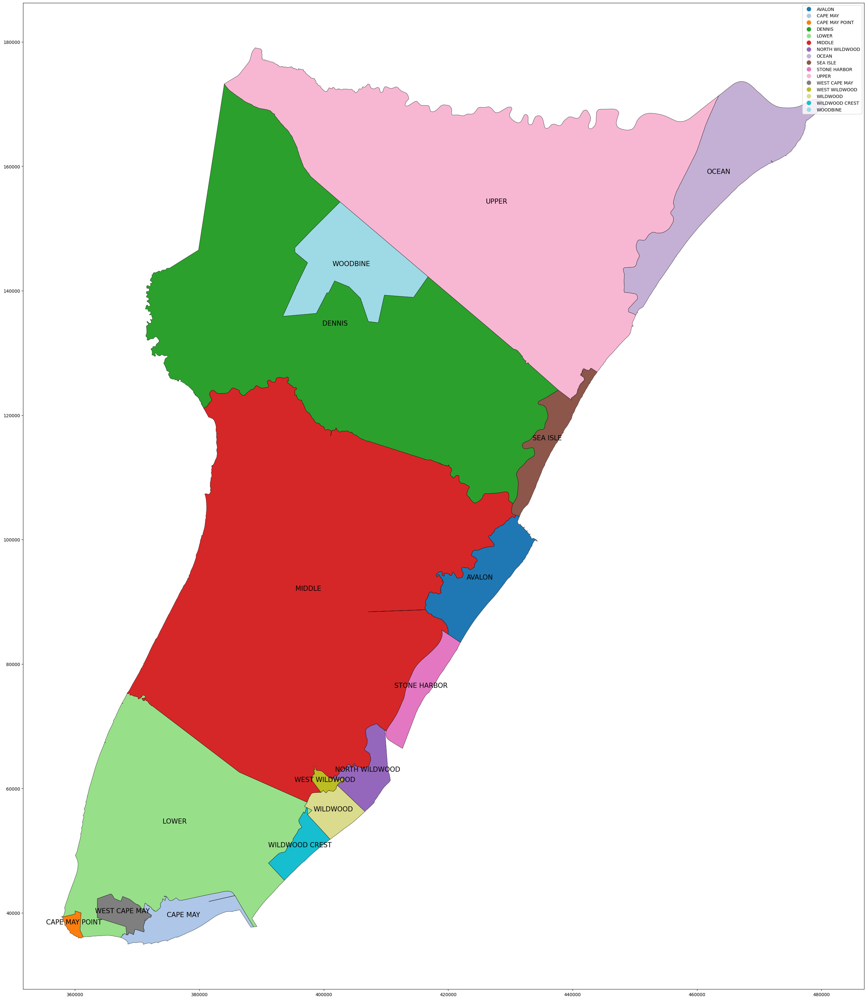

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,LOWER,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,5236,CAPE MAY,34009.0,CAPE MAY,34009.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER,"POLYGON ((367557.889 73711.488, 367577.128 737..."
1,LOWER,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,2872,CAPE MAY,34009.0,CAPE MAY,34009.0,TIM ALEXANDER,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER,"POLYGON ((367557.889 73711.488, 367577.128 737..."
2,LOWER,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,89,CAPE MAY,34009.0,CAPE MAY,34009.0,MICHAEL GALLO,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER,"POLYGON ((367557.889 73711.488, 367577.128 737..."
3,LOWER,US HOUSE,NOT FOR SALE,OTHER,NON-FEDERAL,26,CAPE MAY,34009.0,CAPE MAY,34009.0,ANTHONY PARISI SANCHEZ,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER,"POLYGON ((367557.889 73711.488, 367577.128 737..."
4,LOWER,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,5236,CAPE MAY,34009.0,CAPE MAY,34009.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER,"POLYGON ((372066.121 73519.393, 372124.500 734..."


In [217]:
cape_may_processed = process_county('CAPE MAY', df, gdf_2022)
cape_may_processed.head(5)

### CUMBERLAND COUNTY

['BRIDGETON', 'COMMERCIAL', 'DEERFIELD', 'DOWNE', 'FAIRFIELD', 'GREENWICH', 'HOPEWELL', 'LAWRENCE', 'MAURICE RIVER', 'MILLVILLE', 'SHILOH', 'STOW CREEK', 'UPPER DEERFIELD', 'VINELAND']
['BRIDGETON', 'COMMERCIAL', 'DEERFIELD', 'DOWNE', 'FAIRFIELD', 'GREENWICH', 'HOPEWELL', 'LAWRENCE', 'MAURICE RIVER', 'MILLVILLE', 'SHILOH', 'STOW CREEK', 'UPPER DEERFIELD', 'VINELAND']


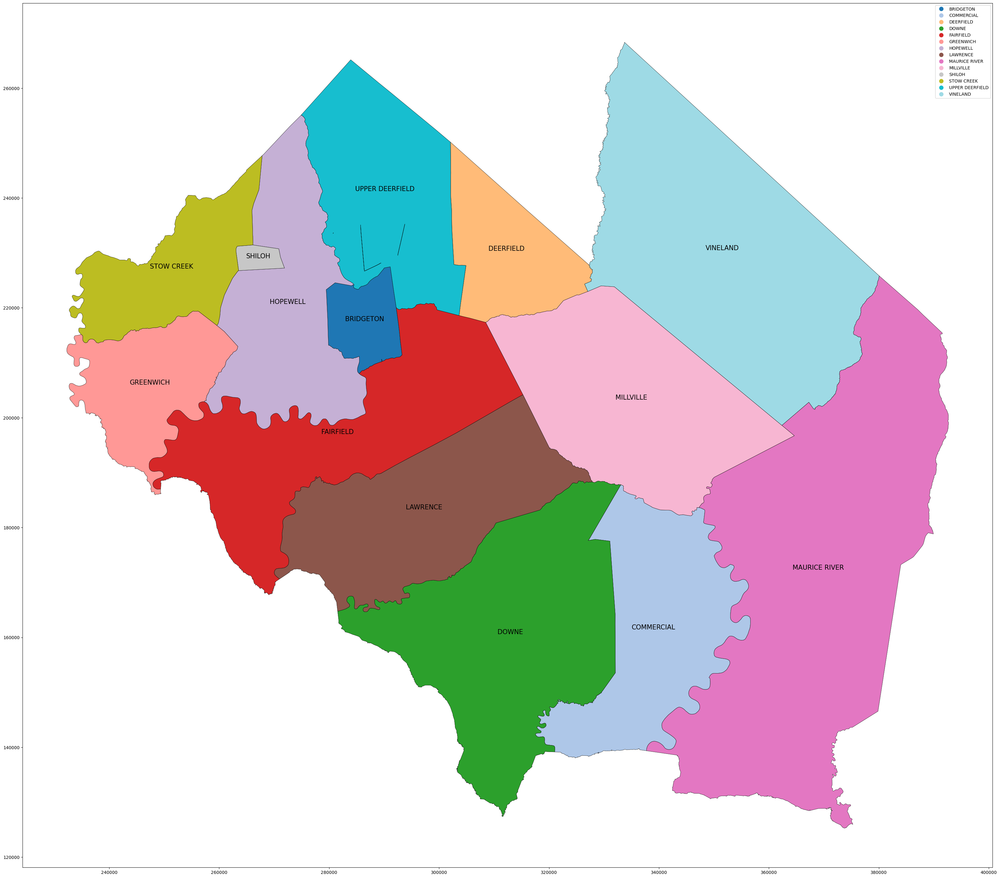

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,BRIDGETON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,570,CUMBERLAND,34011.0,CUMBERLAND,34011.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIDGETON,"POLYGON ((285109.850 223345.140, 285140.582 22..."
1,BRIDGETON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,1310,CUMBERLAND,34011.0,CUMBERLAND,34011.0,TIM ALEXANDER,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIDGETON,"POLYGON ((285109.850 223345.140, 285140.582 22..."
2,BRIDGETON,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,24,CUMBERLAND,34011.0,CUMBERLAND,34011.0,MICHAEL GALLO,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIDGETON,"POLYGON ((285109.850 223345.140, 285140.582 22..."
3,BRIDGETON,US HOUSE,NOT FOR SALE,OTHER,TOTAL,31,CUMBERLAND,34011.0,CUMBERLAND,34011.0,ANTHONY PARISI SANCHEZ,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIDGETON,"POLYGON ((285109.850 223345.140, 285140.582 22..."
4,BRIDGETON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,570,CUMBERLAND,34011.0,CUMBERLAND,34011.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIDGETON,"POLYGON ((292175.095 220309.043, 291747.592 22..."


In [218]:
cumberland_processed = process_county('CUMBERLAND', df, gdf_2022)
cumberland_processed.head(5)

### ESSEX COUNTY

In [219]:
df.loc[(df['county_name'] == 'ESSEX') & (df['precinct'] == 'BLOOMFIELD'), 'precinct'] = 'BLOOMFIELD TOWNSHIP'
df.loc[(df['county_name'] == 'ESSEX') & (df['precinct'] == 'GLEN RIDGE'), 'precinct'] = 'GLEN RIDGE BOROUGH'
df.loc[(df['county_name'] == 'ESSEX') & (df['precinct'] == 'IRVINGTON'), 'precinct'] = 'IRVINGTON TOWNSHIP'
df.loc[(df['county_name'] == 'ESSEX') & (df['precinct'] == 'NEWARK'), 'precinct'] = 'NEWARK CITY'
df.loc[(df['county_name'] == 'ESSEX') & (df['precinct'] == 'NUTLEY'), 'precinct'] = 'NUTLEY TOWNSHIP'

In [220]:
essex_row = df[df['county_name'] == 'ESSEX']
print(essex_row)
gdf_essex = gdf_2022[gdf_2022['COUNTY'] == 'ESSEX']
print(sorted(essex_row['precinct'].unique()))
print(sorted(gdf_essex['MUN_NAME'].unique()))

                  precinct        office           party_detailed  \
1824           NEWARK CITY      US HOUSE                 DEMOCRAT   
1825               FEDERAL      US HOUSE                 DEMOCRAT   
1826           NEWARK CITY      US HOUSE               REPUBLICAN   
1827               FEDERAL      US HOUSE               REPUBLICAN   
1828           NEWARK CITY      US HOUSE                    OTHER   
1829               FEDERAL      US HOUSE                    OTHER   
1830           NEWARK CITY      US HOUSE        LIBERTARIAN PARTY   
1831               FEDERAL      US HOUSE        LIBERTARIAN PARTY   
1832           NEWARK CITY      US HOUSE  SOCIALIST WORKERS PARTY   
1833               FEDERAL      US HOUSE  SOCIALIST WORKERS PARTY   
1834           NEWARK CITY      US HOUSE             LABOUR PARTY   
1835               FEDERAL      US HOUSE             LABOUR PARTY   
1836           NEWARK CITY      US HOUSE          TRUTH AND MERIT   
1837               FEDERAL      US

['BELLEVILLE', 'BLOOMFIELD', 'CALDWELL', 'CEDAR GROVE', 'CITY OF ORANGE', 'EAST ORANGE', 'ESSEX FELLS', 'FAIRFIELD', 'GLEN RIDGE', 'IRVINGTON', 'LIVINGSTON', 'MAPLEWOOD', 'MILLBURN', 'MONTCLAIR', 'NEWARK', 'NORTH CALDWELL', 'NUTLEY', 'ROSELAND', 'SOUTH ORANGE', 'VERONA', 'WEST CALDWELL', 'WEST ORANGE']
['BELLEVILLE', 'BLOOMFIELD', 'CALDWELL', 'CEDAR GROVE', 'CITY OF ORANGE', 'EAST ORANGE', 'ESSEX FELLS', 'FAIRFIELD', 'GLEN RIDGE', 'IRVINGTON', 'LIVINGSTON', 'MAPLEWOOD', 'MILLBURN', 'MONTCLAIR', 'NEWARK', 'NORTH CALDWELL', 'NUTLEY', 'ROSELAND', 'SOUTH ORANGE', 'VERONA', 'WEST CALDWELL', 'WEST ORANGE']


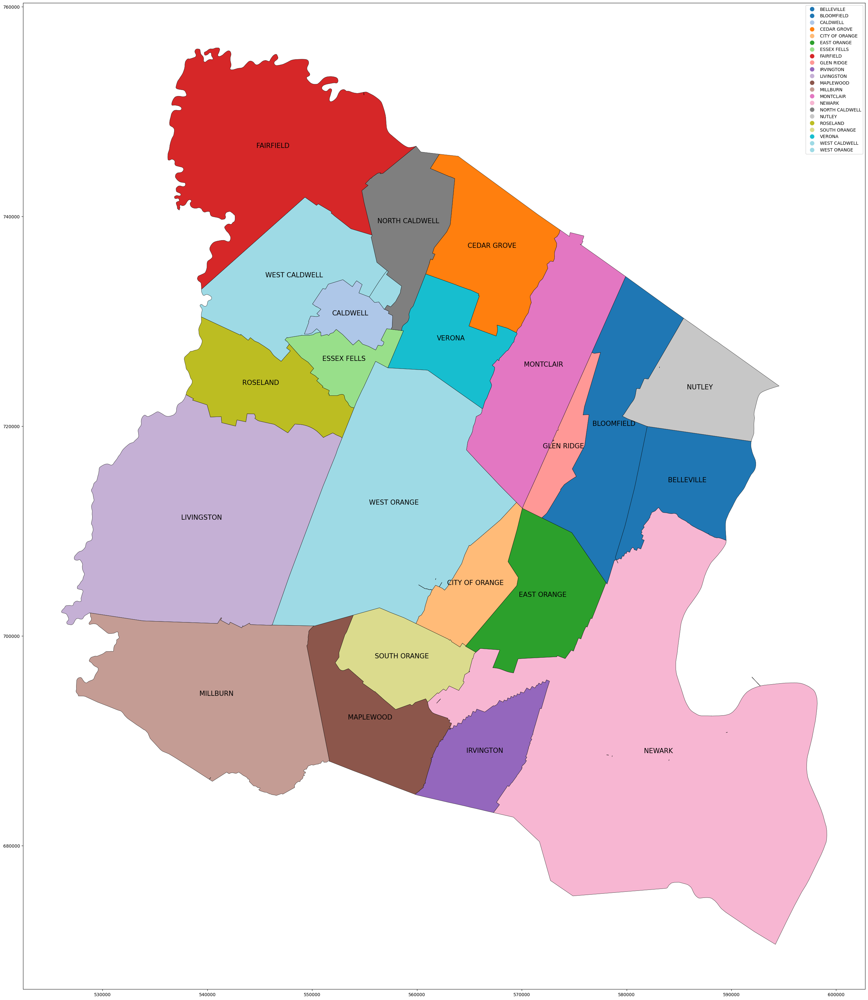

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,LIVINGSTON,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,7606,ESSEX,34013.0,ESSEX,34013.0,MIKIE SHERRILL,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LIVINGSTON,"POLYGON ((552746.148 718971.176, 552813.499 71..."
1,LIVINGSTON,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,3328,ESSEX,34013.0,ESSEX,34013.0,PAUL DEGROOT,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LIVINGSTON,"POLYGON ((552746.148 718971.176, 552813.499 71..."
2,LIVINGSTON,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,89,ESSEX,34013.0,ESSEX,34013.0,JOSEPH BIASCO,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LIVINGSTON,"POLYGON ((552746.148 718971.176, 552813.499 71..."
3,LIVINGSTON,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,7606,ESSEX,34013.0,ESSEX,34013.0,MIKIE SHERRILL,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LIVINGSTON,"POLYGON ((549012.745 708858.591, 548946.266 70..."
4,LIVINGSTON,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,3328,ESSEX,34013.0,ESSEX,34013.0,PAUL DEGROOT,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LIVINGSTON,"POLYGON ((549012.745 708858.591, 548946.266 70..."


In [221]:
essex_processed = process_county('ESSEX', df, gdf_2022)
essex_processed.head(5)

### GLOUCESTER COUNTY

In [222]:
allocate_votes(df, 'GLOUCESTER', 'TIM ALEXANDER', 6)
allocate_votes(df, 'GLOUCESTER', 'JEFF VAN DREW', 2)
allocate_votes(df, 'GLOUCESTER', 'PATRICIA KLINE', 1)
allocate_votes(df, 'GLOUCESTER', 'CLAIRE GUSTAFSON', 1)
allocate_votes(df, 'GLOUCESTER', 'DONALD W NORCROSS', 25)

['CLAYTON', 'DEPTFORD', 'EAST GREENWICH', 'ELK', 'FRANKLIN', 'GLASSBORO', 'GREENWICH', 'HARRISON', 'LOGAN', 'MANTUA', 'MONROE', 'NATIONAL PARK', 'NEWFIELD', 'PAULSBORO', 'PITMAN', 'SOUTH HARRISON', 'SWEDESBORO', 'WASHINGTON', 'WENONAH', 'WEST DEPTFORD', 'WESTVILLE', 'WOODBURY', 'WOODBURY HEIGHTS', 'WOOLWICH']
['CLAYTON', 'DEPTFORD', 'EAST GREENWICH', 'ELK', 'FRANKLIN', 'GLASSBORO', 'GREENWICH', 'HARRISON', 'LOGAN', 'MANTUA', 'MONROE', 'NATIONAL PARK', 'NEWFIELD', 'PAULSBORO', 'PITMAN', 'SOUTH HARRISON', 'SWEDESBORO', 'WASHINGTON', 'WENONAH', 'WEST DEPTFORD', 'WESTVILLE', 'WOODBURY', 'WOODBURY HEIGHTS', 'WOOLWICH']


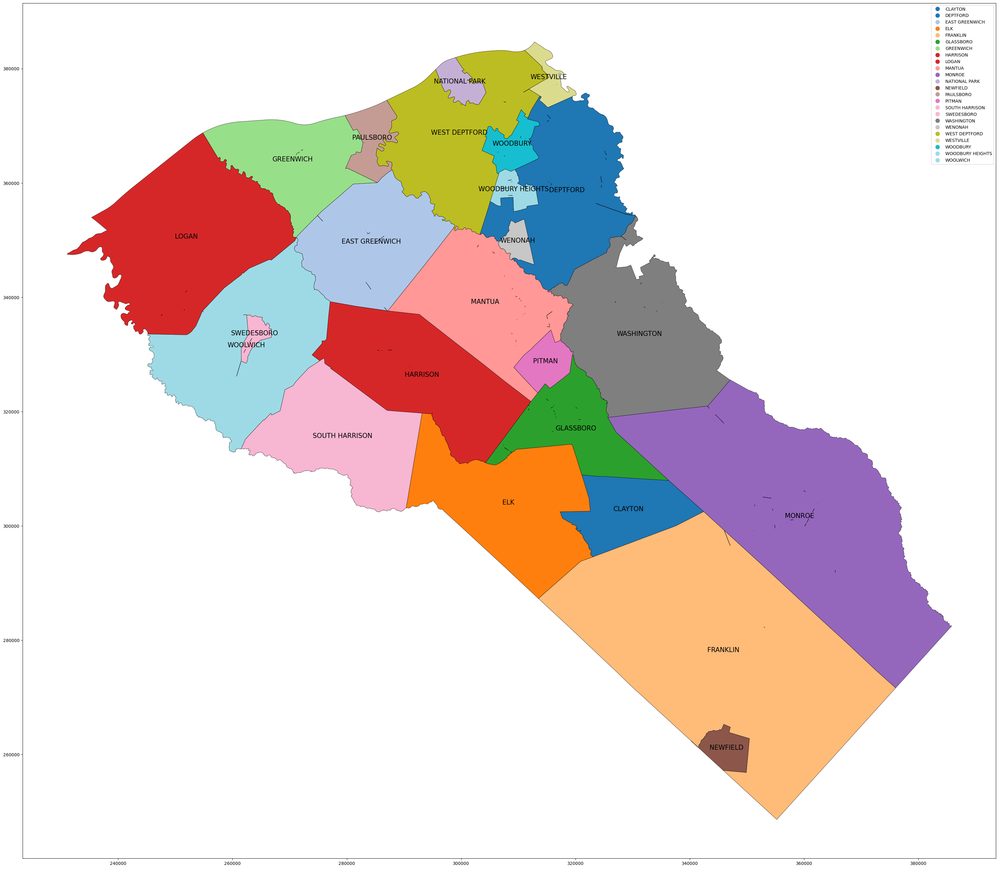

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,LOGAN,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,942,GLOUCESTER,34015.0,GLOUCESTER,34015.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOGAN,"POLYGON ((250501.648 335621.712, 250604.155 33..."
1,LOGAN,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,1138,GLOUCESTER,34015.0,GLOUCESTER,34015.0,TIM ALEXANDER,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOGAN,"POLYGON ((250501.648 335621.712, 250604.155 33..."
2,LOGAN,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,28,GLOUCESTER,34015.0,GLOUCESTER,34015.0,MICHAEL GALLO,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOGAN,"POLYGON ((250501.648 335621.712, 250604.155 33..."
3,LOGAN,US HOUSE,NOT FOR SALE,OTHER,NON-FEDERAL,14,GLOUCESTER,34015.0,GLOUCESTER,34015.0,ANTHONY PARISI SANCHEZ,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOGAN,"POLYGON ((250501.648 335621.712, 250604.155 33..."
4,LOGAN,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,942,GLOUCESTER,34015.0,GLOUCESTER,34015.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOGAN,"POLYGON ((250103.729 339284.621, 250109.503 33..."


In [223]:
gloucester_processed = process_county('GLOUCESTER', df, gdf_2022)
gloucester_processed.head(5)

### HUDSON COUNTY

In [224]:
allocate_votes(df, 'HUDSON', 'ROBERT J MENENDEZ', 36)
allocate_votes(df, 'HUDSON', 'DAVID H PINCKNEY', 2)
allocate_votes(df, 'HUDSON', 'BILLY PREMPEH', 1)
allocate_votes(df, 'HUDSON', 'MARCOS ARROYO', 1)
allocate_votes(df, 'HUDSON', 'BILL PASCRELL JR', 4)
allocate_votes(df, 'HUDSON', 'DONALD M PAYNE JR', 7)

['BAYONNE', 'EAST NEWARK', 'GUTTENBERG', 'HARRISON', 'HOBOKEN', 'JERSEY', 'KEARNY', 'NORTH BERGEN', 'SECAUCUS', 'UNION', 'WEEHAWKEN', 'WEST NEW YORK']
['BAYONNE', 'EAST NEWARK', 'GUTTENBERG', 'HARRISON', 'HOBOKEN', 'JERSEY', 'KEARNY', 'NORTH BERGEN', 'SECAUCUS', 'UNION', 'WEEHAWKEN', 'WEST NEW YORK']


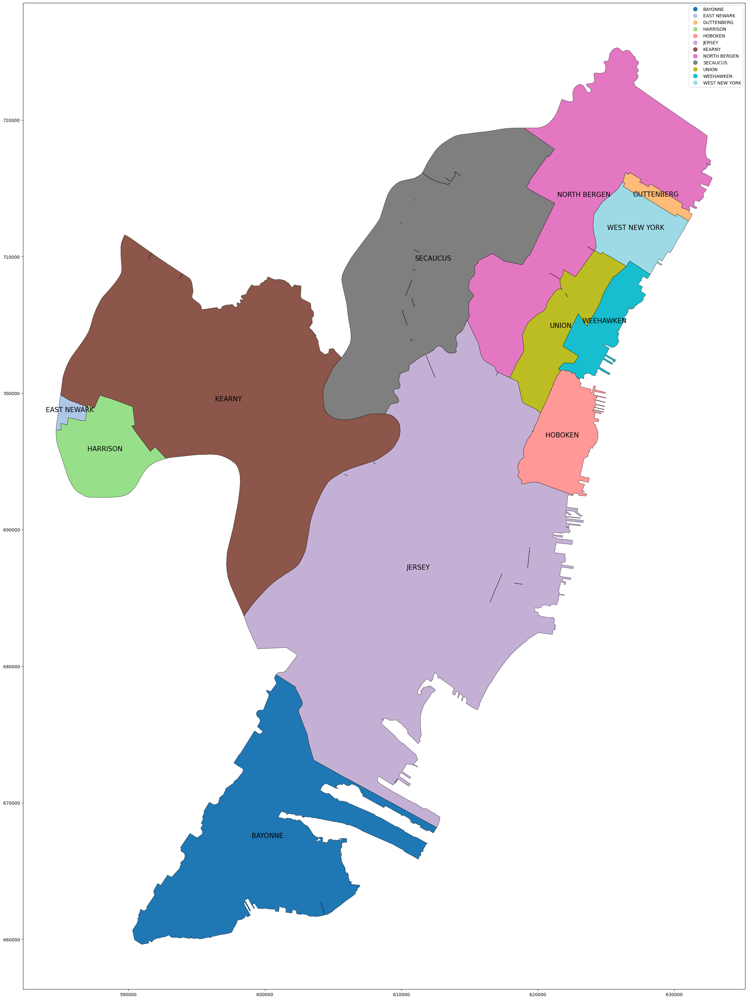

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,UNION,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,10785,HUDSON,34017.0,HUDSON,34017.0,ROBERT J MENENDEZ,8.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,UNION,"POLYGON ((622726.072 706170.256, 622794.220 70..."
1,UNION,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,1946,HUDSON,34017.0,HUDSON,34017.0,MARCOS ARROYO,8.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,UNION,"POLYGON ((622726.072 706170.256, 622794.220 70..."
2,UNION,US HOUSE,OTHER,OTHER,NON-FEDERAL,51,HUDSON,34017.0,HUDSON,34017.0,DAVID W COOK,8.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,UNION,"POLYGON ((622726.072 706170.256, 622794.220 70..."
3,UNION,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,31,HUDSON,34017.0,HUDSON,34017.0,DAN DELANEY,8.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,UNION,"POLYGON ((622726.072 706170.256, 622794.220 70..."
4,UNION,US HOUSE,SOCIALIST WORKERS PARTY,OTHER,NON-FEDERAL,79,HUDSON,34017.0,HUDSON,34017.0,JOANNE KUNIANSKY,8.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,UNION,"POLYGON ((622726.072 706170.256, 622794.220 70..."


In [225]:
hudson_processed = process_county('HUDSON', df, gdf_2022)
hudson_processed.head(5)

### HUNTERDON COUNTY

['ALEXANDRIA', 'BETHLEHEM', 'BLOOMSBURY', 'CALIFON', 'CLINTON', 'DELAWARE', 'EAST AMWELL', 'FLEMINGTON', 'FRANKLIN', 'FRENCHTOWN', 'GLEN GARDNER', 'HAMPTON', 'HIGH BRIDGE', 'HOLLAND', 'KINGWOOD', 'LAMBERTVILLE', 'LEBANON', 'MILFORD', 'RARITAN', 'READINGTON', 'STOCKTON', 'TEWKSBURY', 'UNION', 'WEST AMWELL']
['ALEXANDRIA', 'BETHLEHEM', 'BLOOMSBURY', 'CALIFON', 'CLINTON', 'DELAWARE', 'EAST AMWELL', 'FLEMINGTON', 'FRANKLIN', 'FRENCHTOWN', 'GLEN GARDNER', 'HAMPTON', 'HIGH BRIDGE', 'HOLLAND', 'KINGWOOD', 'LAMBERTVILLE', 'LEBANON', 'MILFORD', 'RARITAN', 'READINGTON', 'STOCKTON', 'TEWKSBURY', 'UNION', 'WEST AMWELL']


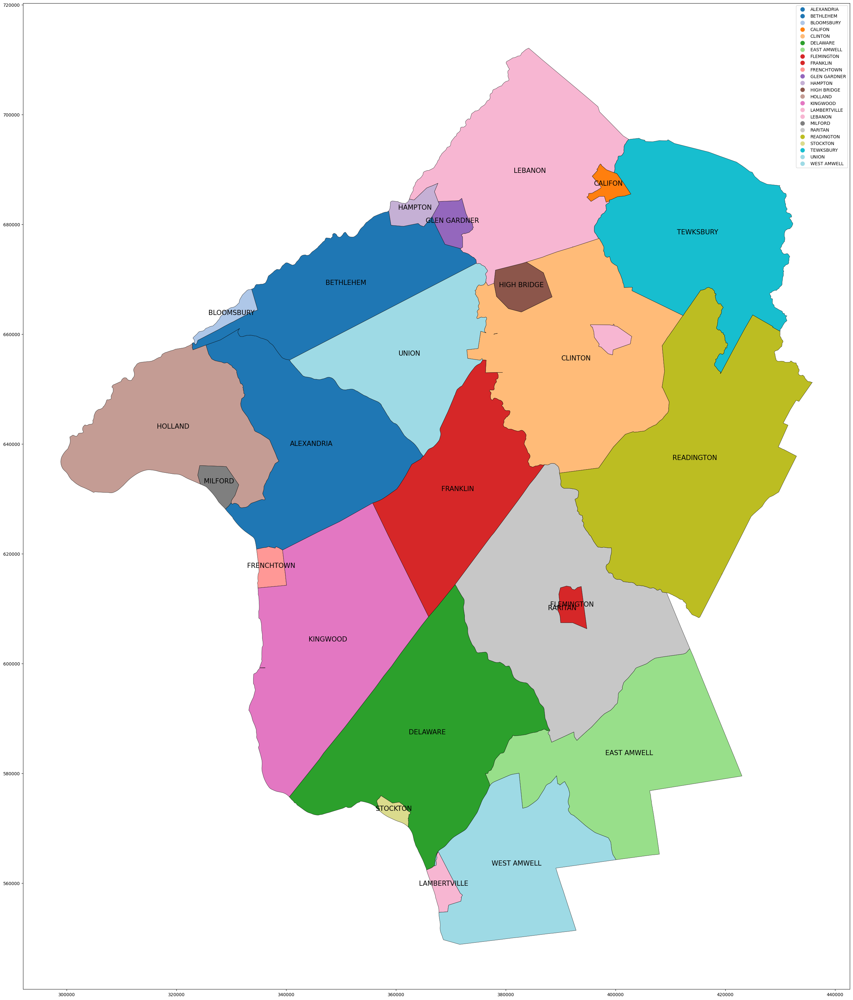

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,READINGTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,3257,HUNTERDON,34019.0,HUNTERDON,34019.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,READINGTON,"POLYGON ((405041.310 614152.000, 404988.259 61..."
1,READINGTON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,4692,HUNTERDON,34019.0,HUNTERDON,34019.0,THOMAS H KEAN JR,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,READINGTON,"POLYGON ((405041.310 614152.000, 404988.259 61..."
2,HIGH BRIDGE,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,860,HUNTERDON,34019.0,HUNTERDON,34019.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,HIGH BRIDGE,"POLYGON ((381886.435 667144.938, 381731.125 66..."
3,HIGH BRIDGE,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,796,HUNTERDON,34019.0,HUNTERDON,34019.0,THOMAS H KEAN JR,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,HIGH BRIDGE,"POLYGON ((381886.435 667144.938, 381731.125 66..."
4,CLINTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,713,HUNTERDON,34019.0,HUNTERDON,34019.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLINTON,"POLYGON ((390363.770 668356.144, 390397.210 66..."


In [226]:
hunterdon_processed = process_county('HUNTERDON', df, gdf_2022)
hunterdon_processed.head(5)

### MERCER COUNTY

In [227]:
allocate_votes(df, 'MERCER', 'BONNIE WATSON COLEMAN', 201)
allocate_votes(df, 'MERCER', 'DARIUS MAYFIELD', 16)

['EAST WINDSOR', 'EWING', 'HAMILTON', 'HIGHTSTOWN', 'HOPEWELL', 'LAWRENCE', 'PENNINGTON', 'PRINCETON', 'ROBBINSVILLE', 'TRENTON', 'WEST WINDSOR']
['EAST WINDSOR', 'EWING', 'HAMILTON', 'HIGHTSTOWN', 'HOPEWELL', 'LAWRENCE', 'PENNINGTON', 'PRINCETON', 'ROBBINSVILLE', 'TRENTON', 'WEST WINDSOR']


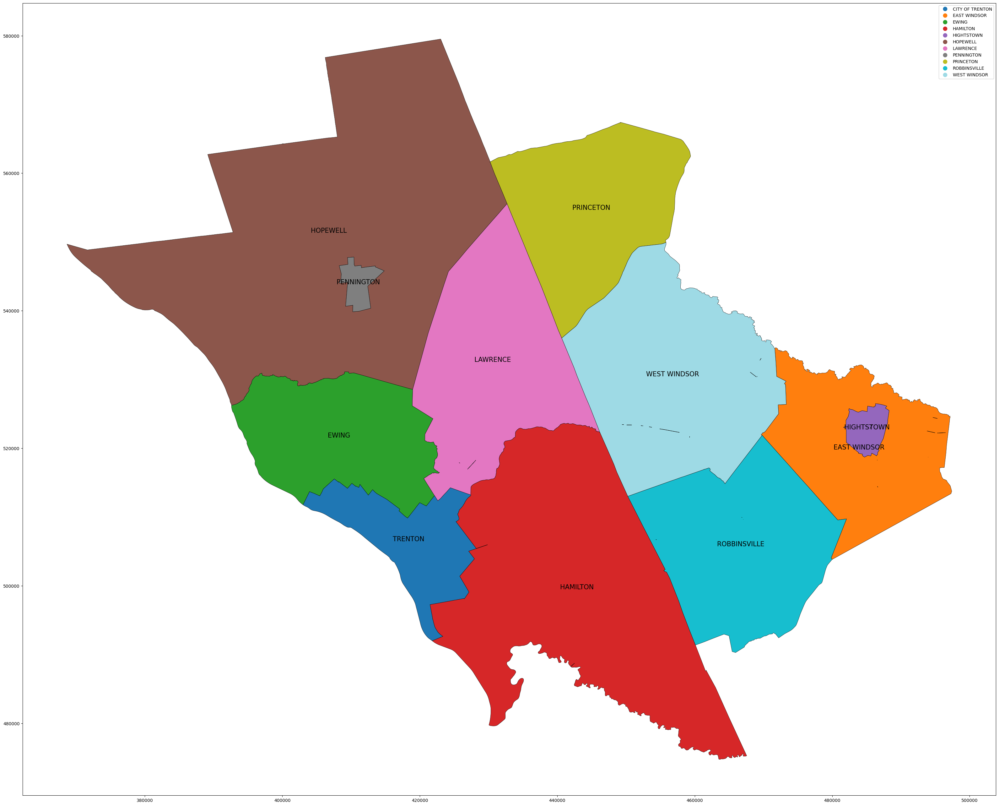

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,LAWRENCE,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,7891,MERCER,34021.0,MERCER,34021.0,ANDY KIM,3.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAWRENCE,"POLYGON ((437979.570 522990.080, 437941.950 52..."
1,LAWRENCE,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,2936,MERCER,34021.0,MERCER,34021.0,BOB HEALEY,3.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAWRENCE,"POLYGON ((437979.570 522990.080, 437941.950 52..."
2,LAWRENCE,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,75,MERCER,34021.0,MERCER,34021.0,CHRISTOPHER RUSSOMANNO,3.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAWRENCE,"POLYGON ((437979.570 522990.080, 437941.950 52..."
3,LAWRENCE,US HOUSE,GOD SAVE AMERICA,OTHER,NON-FEDERAL,31,MERCER,34021.0,MERCER,34021.0,GREGORY M SOBOCINSKI,3.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAWRENCE,"POLYGON ((437979.570 522990.080, 437941.950 52..."
4,LAWRENCE,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,7891,MERCER,34021.0,MERCER,34021.0,ANDY KIM,3.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAWRENCE,"POLYGON ((425686.480 523621.513, 425616.855 52..."


In [228]:
# Create a manual mapping dictionary
manual_mapping = {
    'CITY OF TRENTON': 'TRENTON',
}

mercer_processed = process_county('MERCER', df, gdf_2022, manual_mapping=manual_mapping)
mercer_processed.head(5)

### MIDDLESEX COUNTY

['CARTERET', 'CRANBURY', 'DUNELLEN', 'EAST BRUNSWICK', 'EDISON', 'HELMETTA', 'HIGHLAND PARK', 'JAMESBURG', 'METUCHEN', 'MIDDLESEX', 'MILLTOWN', 'MONROE', 'NEW BRUNSWICK', 'NORTH BRUNSWICK', 'OLD BRIDGE', 'PERTH AMBOY', 'PISCATAWAY', 'PLAINSBORO', 'SAYREVILLE', 'SOUTH AMBOY', 'SOUTH BRUNSWICK', 'SOUTH PLAINFIELD', 'SOUTH RIVER', 'SPOTSWOOD', 'WOODBRIDGE']
['CARTERET', 'CRANBURY', 'DUNELLEN', 'EAST BRUNSWICK', 'EDISON', 'HELMETTA', 'HIGHLAND PARK', 'JAMESBURG', 'METUCHEN', 'MIDDLESEX', 'MILLTOWN', 'MONROE', 'NEW BRUNSWICK', 'NORTH BRUNSWICK', 'OLD BRIDGE', 'PERTH AMBOY', 'PISCATAWAY', 'PLAINSBORO', 'SAYREVILLE', 'SOUTH AMBOY', 'SOUTH BRUNSWICK', 'SOUTH PLAINFIELD', 'SOUTH RIVER', 'SPOTSWOOD', 'WOODBRIDGE']


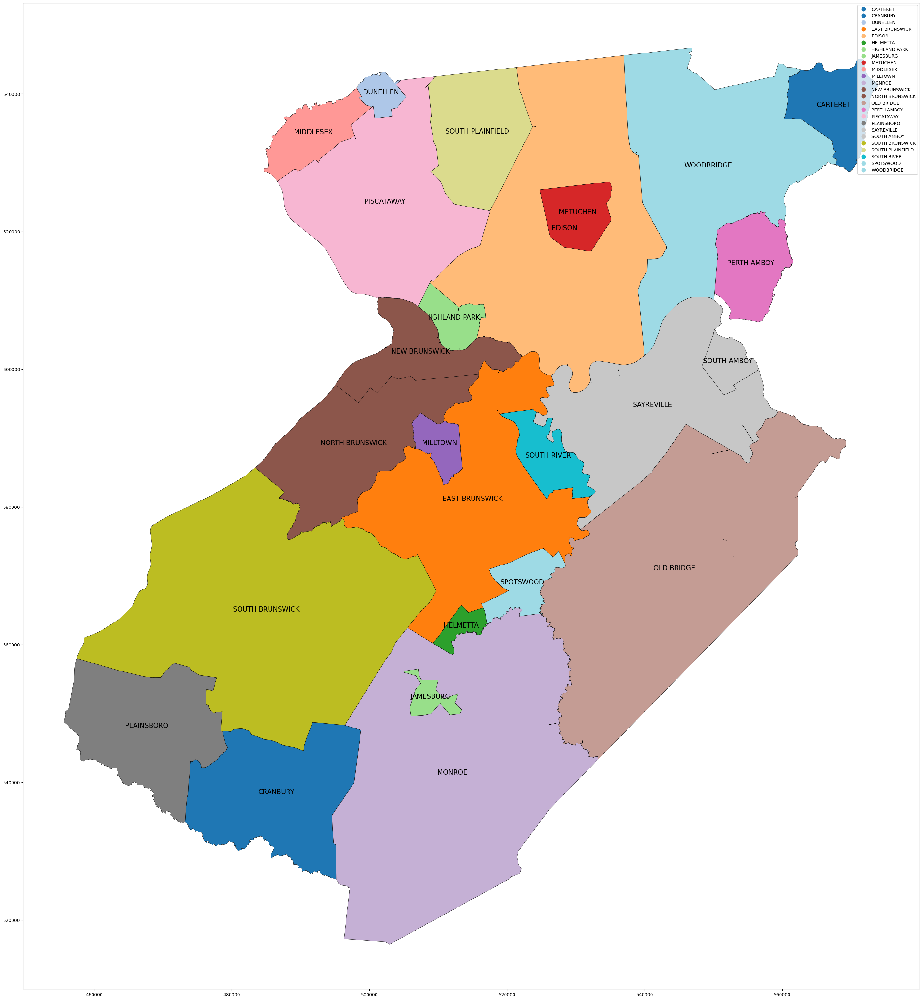

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,EDISON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,13774,MIDDLESEX,34023.0,MIDDLESEX,34023.0,FRANK PALLONE JR,6.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,EDISON,"POLYGON ((516421.309 609449.308, 516393.295 60..."
1,EDISON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,7993,MIDDLESEX,34023.0,MIDDLESEX,34023.0,SUSAN M KILEY,6.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,EDISON,"POLYGON ((516421.309 609449.308, 516393.295 60..."
2,EDISON,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,117,MIDDLESEX,34023.0,MIDDLESEX,34023.0,TARA FISHER,6.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,EDISON,"POLYGON ((516421.309 609449.308, 516393.295 60..."
3,EDISON,US HOUSE,NEW JERSEY FIRST,OTHER,TOTAL,264,MIDDLESEX,34023.0,MIDDLESEX,34023.0,INDER JIT SONI,6.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,EDISON,"POLYGON ((516421.309 609449.308, 516393.295 60..."
4,EDISON,US HOUSE,MOVE EVERYONE,OTHER,TOTAL,65,MIDDLESEX,34023.0,MIDDLESEX,34023.0,ERIC ANTISELL,6.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,EDISON,"POLYGON ((516421.309 609449.308, 516393.295 60..."


In [272]:
middlesex_processed = process_county('MIDDLESEX', df, gdf_2022)
middlesex_processed.head(5)

### MONMOUTH COUNTY

In [230]:
monmouth_row = df[df['county_name'] == 'MONMOUTH']
gdf_monmouth = gdf_2022[gdf_2022['COUNTY'] == 'MONMOUTH']
print(sorted(monmouth_row['precinct'].unique()))
print(sorted(gdf_monmouth['MUN_NAME'].unique()))

['ABERDEEN TOWNSHIP', 'ALLENHURST BOROUGH', 'ALLENTOWN BOROUGH', 'ASBURY PARK CITY', 'ATLANTIC HIGHLANDS BOROUGH', 'AVON-BY-THE-SEA BOROUGH', 'BELMAR BOROUGH', 'BRADLEY BEACH BOROUGH', 'BRIELLE BOROUGH', 'COLTS NECK TOWNSHIP', 'DEAL BOROUGH', 'EATONTOWN BOROUGH', 'ENGLISHTOWN BOROUGH', 'FAIR HAVEN BOROUGH', 'FARMINGDALE BOROUGH', 'FREEHOLD BOROUGH', 'FREEHOLD TOWNSHIP', 'HAZLET TOWNSHIP', 'HIGHLANDS BOROUGH', 'HOLMDEL TOWNSHIP', 'HOWELL TOWNSHIP', 'INTERLAKEN BOROUGH', 'KEANSBURG BOROUGH', 'KEYPORT BOROUGH', 'LAKE COMO BOROUGH', 'LITTLE SILVER BOROUGH', 'LOCH ARBOUR VILLAGE', 'LONG BRANCH CITY', 'MANALAPAN TOWNSHIP', 'MANASQUAN BOROUGH', 'MARLBORO TOWNSHIP', 'MATAWAN BOROUGH', 'MIDDLETOWN TOWNSHIP', 'MILLSTONE TOWNSHIP', 'MONMOUTH BEACH BOROUGH', 'NEPTUNE CITY BOROUGH', 'NEPTUNE TOWNSHIP', 'OCEAN TOWNSHIP', 'OCEANPORT BOROUGH', 'RED BANK BOROUGH', 'ROOSEVELT BOROUGH', 'RUMSON BOROUGH', 'SEA BRIGHT BOROUGH', 'SEAGIRT BOROUGH', 'SHREWSBURY BOROUGH', 'SHREWSBURY TOWNSHIP', 'SPRING LAKE BO

I got rid of BOROUGH and TOWNSHIP just for convenience, but here, FREEHOLD BOROUGH and FREEHOLD TOWNSHIP are two different places, which means that I need to distinguish. So I made FREEHOLD BOROUGH to FREEHOLD BOROUGHMONMOUTH for both election result and precinct boundaries.

In [231]:
gdf_2022.loc[gdf_2022['MUN_NAME'] == 'FREEHOLD BOROUGH', 'MUN_NAME'] = 'FREEHOLD BOROUGHMONMOUTH'
df.loc[df['precinct'] == 'FREEHOLD BOROUGH', 'precinct'] = 'FREEHOLD BOROUGHMONMOUTH'

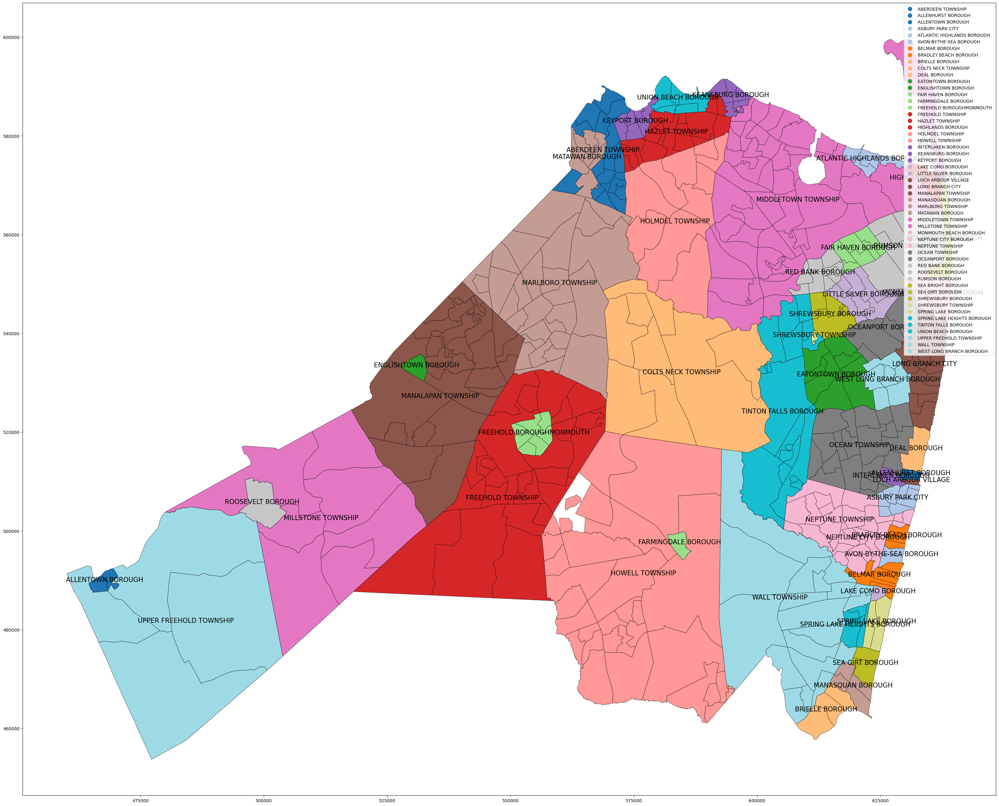

In [232]:
fig, ax = plt.subplots(figsize=(40, 40))

gdf_monmouth = gdf_2022[gdf_2022['COUNTY'] == 'MONMOUTH']

gdf_monmouth['geometry'] = gdf_monmouth['geometry'].buffer(0)

# Plot the geometries for the county with improved borders
gdf_monmouth.plot(column='MUN_NAME', ax=ax, legend=True, cmap='tab20', edgecolor='black', linewidth=0.5)

gdf_monmouth = gdf_monmouth.dissolve(by='MUN_NAME', as_index=False)


# Add labels to each precinct based on manual_mapping flag
for x, y, label in zip(gdf_monmouth.geometry.centroid.x, gdf_monmouth.geometry.centroid.y, gdf_monmouth['MUN_NAME']):
    ax.text(x, y, label, fontsize=15, ha='center')  # Adjust font size as needed


plt.show()

Missing mappings for the following precincts: ['ALLENTOWN' 'ENGLISHTOWN' 'FREEHOLD BOROUGHMONMOUTH' 'FREEHOLD' 'HOLMDEL'
 'MANALAPAN' 'MARLBORO' 'MILLSTONE' 'ROOSEVELT' 'UPPER FREEHOLD'
 'AVON-BY-THE-SEA' 'BELMAR' 'BRIELLE' 'COLTS NECK' 'EATONTOWN'
 'FARMINGDALE' 'HOWELL' 'LAKE COMO' 'MANASQUAN' 'MIDDLETOWN' 'OCEAN'
 'SHREWSBURY' 'SPRING LAKE' 'TINTON FALLS' 'WALL' 'ABERDEEN' 'ALLENHURST'
 'ASBURY PARK' 'ATLANTIC HIGHLANDS' 'BRADLEY BEACH' 'DEAL' 'FAIR HAVEN'
 'HAZLET' 'HIGHLANDS' 'INTERLAKEN' 'KEANSBURG' 'KEYPORT' 'LITTLE SILVER'
 'LOCH ARBOUR' 'LONG BRANCH' 'MATAWAN' 'MONMOUTH BEACH' 'NEPTUNE'
 'NEPTUNE CITY' 'OCEANPORT' 'RED BANK' 'RUMSON' 'SEA BRIGHT' 'UNION BEACH'
 'WEST LONG BRANCH']
['ABERDEEN', 'ALLENHURST', 'ALLENTOWN', 'ASBURY PARK', 'ATLANTIC HIGHLANDS', 'AVON-BY-THE-SEA', 'BELMAR', 'BRADLEY BEACH', 'BRIELLE', 'COLTS NECK', 'DEAL', 'EATONTOWN', 'ENGLISHTOWN', 'FAIR HAVEN', 'FARMINGDALE', 'FREEHOLD', 'FREEHOLD BOROUGHMONMOUTH', 'HAZLET', 'HIGHLANDS', 'HOLMDEL', 'HOWELL', 'INT

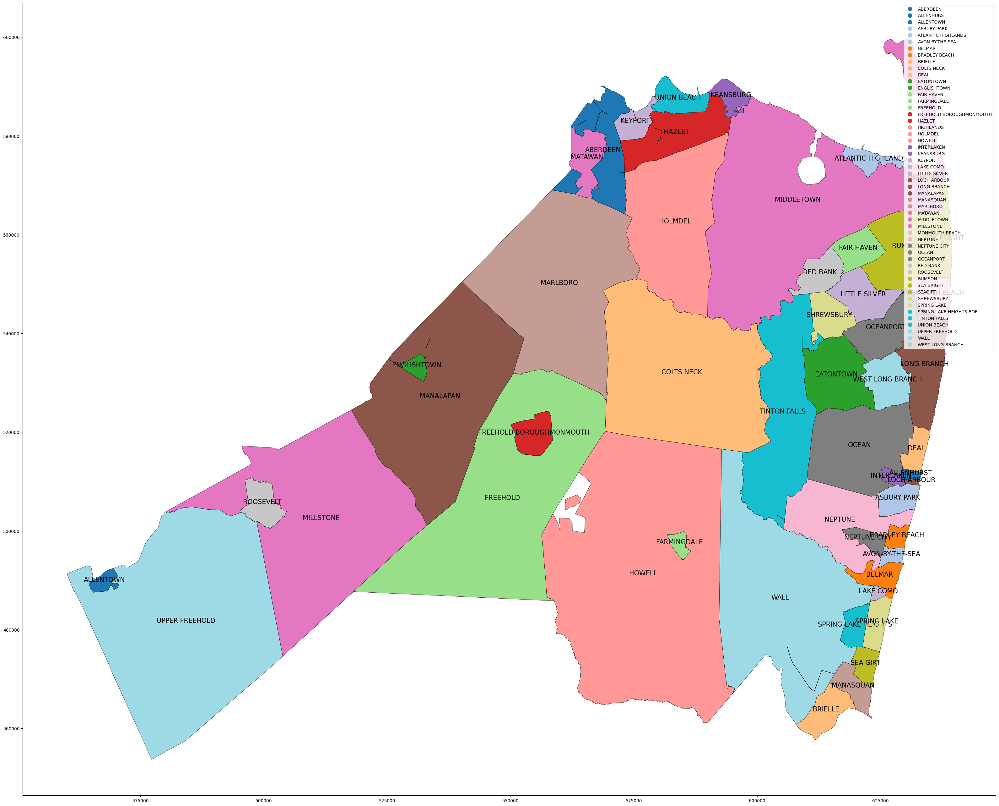

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,BRIELLE,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,1645,MONMOUTH,34025.0,MONMOUTH,34025.0,CHRISTOPHER H SMITH,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIELLE,"POLYGON ((615634.072 460523.903, 615491.480 46..."
1,BRIELLE,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,710,MONMOUTH,34025.0,MONMOUTH,34025.0,MATTHEW JENKINS,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIELLE,"POLYGON ((615634.072 460523.903, 615491.480 46..."
2,BRIELLE,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,20,MONMOUTH,34025.0,MONMOUTH,34025.0,JASON CULLEN,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIELLE,"POLYGON ((615634.072 460523.903, 615491.480 46..."
3,BRIELLE,US HOUSE,WE THE PEOPLE,OTHER,TOTAL,12,MONMOUTH,34025.0,MONMOUTH,34025.0,DAVID SCHMIDT,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIELLE,"POLYGON ((615634.072 460523.903, 615491.480 46..."
4,BRIELLE,US HOUSE,NO SLOGAN FILED,OTHER,TOTAL,44,MONMOUTH,34025.0,MONMOUTH,34025.0,HANK SCHROEDER,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,BRIELLE,"POLYGON ((615634.072 460523.903, 615491.480 46..."


In [271]:
manual_mapping = {
    'SEAGIRT': 'SEA GIRT',
    'SPRING LAKE HEIGHTS BOR': 'SPRING LAKE HEIGHTS',
}

monmouth_processed = process_county('MONMOUTH', df, gdf_2022, manual_mapping)
monmouth_processed.head(5)

### MORRIS COUNTY

In [234]:
allocate_votes(df, 'MORRIS', 'MIKIE SHERRILL', 228)
allocate_votes(df, 'MORRIS', 'TOM MALINOWSKI', 56)
allocate_votes(df, 'MORRIS', 'JOSEPH BIASCO', 1)
allocate_votes(df, 'MORRIS', 'THOMAS H KEAN JR', 4)
allocate_votes(df, 'MORRIS', 'PAUL DEGROOT', 17)

['BOONTON', 'BUTLER', 'CHATHAM', 'CHESTER', 'DENVILLE', 'DOVER', 'EAST HANOVER', 'FLORHAM PARK', 'HANOVER', 'HARDING', 'JEFFERSON', 'KINNELON', 'LINCOLN PARK', 'LONG HILL', 'MADISON', 'MENDHAM', 'MINE HILL', 'MONTVILLE', 'MORRIS', 'MORRIS PLAINS', 'MORRISTOWN', 'MOUNT ARLINGTON', 'MOUNT OLIVE', 'MOUNTAIN LAKES', 'NETCONG', 'PARSIPPANY-TROY HILLS', 'PEQUANNOCK', 'RANDOLPH', 'RIVERDALE', 'ROCKAWAY', 'ROXBURY', 'VICTORY GARDENS', 'WASHINGTON', 'WHARTON']
['BOONTON', 'BUTLER', 'CHATHAM', 'CHESTER', 'DENVILLE', 'DOVER', 'EAST HANOVER', 'FLORHAM PARK', 'HANOVER', 'HARDING', 'JEFFERSON', 'KINNELON', 'LINCOLN PARK', 'LONG HILL', 'MADISON', 'MENDHAM', 'MINE HILL', 'MONTVILLE', 'MORRIS', 'MORRIS PLAINS', 'MORRISTOWN', 'MOUNT ARLINGTON', 'MOUNT OLIVE', 'MOUNTAIN LAKES', 'NETCONG', 'PARSIPPANY-TROY HILLS', 'PEQUANNOCK', 'RANDOLPH', 'RIVERDALE', 'ROCKAWAY', 'ROXBURY', 'VICTORY GARDENS', 'WASHINGTON', 'WHARTON']


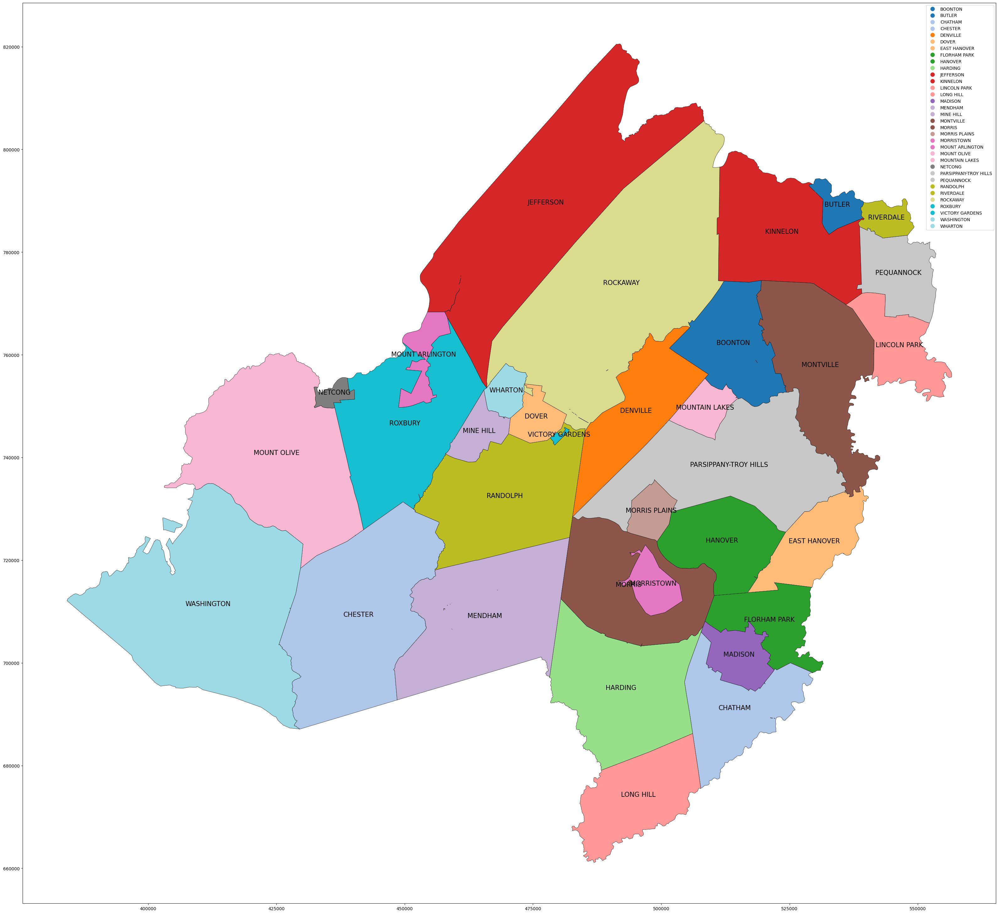

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,PARSIPPANY-TROY HILLS,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,8942,MORRIS,34027.0,MORRIS,34027.0,MIKIE SHERRILL,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,PARSIPPANY-TROY HILLS,"POLYGON ((527927.666 744623.024, 527889.250 74..."
1,PARSIPPANY-TROY HILLS,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,6797,MORRIS,34027.0,MORRIS,34027.0,PAUL DEGROOT,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,PARSIPPANY-TROY HILLS,"POLYGON ((527927.666 744623.024, 527889.250 74..."
2,PARSIPPANY-TROY HILLS,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,142,MORRIS,34027.0,MORRIS,34027.0,JOSEPH BIASCO,11.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,PARSIPPANY-TROY HILLS,"POLYGON ((527927.666 744623.024, 527889.250 74..."
3,MOUNT OLIVE,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,4658,MORRIS,34027.0,MORRIS,34027.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,MOUNT OLIVE,"POLYGON ((434795.003 739268.138, 434782.529 73..."
4,MOUNT OLIVE,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,4834,MORRIS,34027.0,MORRIS,34027.0,THOMAS H KEAN JR,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,MOUNT OLIVE,"POLYGON ((434795.003 739268.138, 434782.529 73..."


In [235]:
morris_processed = process_county('MORRIS', df, gdf_2022)
morris_processed.head(5)

### OCEAN COUNTY

In [273]:
ocean_row = df[df['county_name'] == 'OCEAN']
gdf_ocean = gdf_2022[gdf_2022['COUNTY'] == 'OCEAN']
print(sorted(ocean_row['precinct'].unique()))
print(sorted(gdf_ocean['MUN_NAME'].unique()))

['BARNEGAT', 'BARNEGAT LIGHT', 'BAY HEAD BOROUGH', 'BEACH HAVEN', 'BEACHWOOD BOROUGH', 'BERKELEY TOWNSHIP', 'BRICK TOWNSHIP', 'EAGLESWOOD TOWNSHIP', 'HARVEY CEDARS BOROUGH', 'ISLAND HEIGHTS', 'JACKSON TOWNSHIP', 'LACEY TOWNSHIP', 'LAKEHURST BOROUGH', 'LAKEWOOD TOWNSHIP', 'LAVALLETTE BOROUGH', 'LITTLE EGG HARBOR TOWNSHIP', 'LONG BEACH TOWNSHIP', 'MANCHESTER TOWNSHIP', 'MANTOLOKING BOROUGH', 'OCEAN', 'OCEAN GATE BOROUGH', 'PINE BEACH BOROUGH', 'PLUMSTED', 'PLUMSTED TOWNSHIP', 'POINT PLEASANT BEACH', 'POINT PLEASANT BOROUGH', 'SEASIDE HEIGHTS BOROUGH', 'SEASIDE PARK BOROUGH', 'SHIP BOTTOM BOROUGH', 'SOUTH TOMS RIVER BOROUGH', 'STAFFORD TOWNSHIP', 'SURF CITY BOROUGH', 'TOMS RIVER TOWNSHIP', 'TUCKERTON BOROUGH']
['BARNEGAT LIGHT BOROUGH', 'BARNEGAT TOWNSHIP', 'BAY HEAD BOROUGH', 'BEACH HAVEN BOROUGH', 'BEACHWOOD BOROUGH', 'BERKELEY TOWNSHIP', 'BRICK TOWNSHIP', 'EAGLESWOOD TOWNSHIP', 'HARVEY CEDARS BOROUGH', 'ISLAND HEIGHTS BOROUGH', 'JACKSON TOWNSHIP', 'LACEY TOWNSHIP', 'LAKEHURST BOROUGH',

In [265]:
df.loc[df['precinct'] == 'POINT PLEASANT BEACH BOR', 'precinct'] = 'POINT PLEASANT BEACH'
df.loc[df['precinct'] == 'BERKELEY', 'precinct'] = 'BERKELEY TOWNSHIP'
df.loc[df['precinct'] == 'LACEY', 'precinct'] = 'LACEY TOWNSHIP'

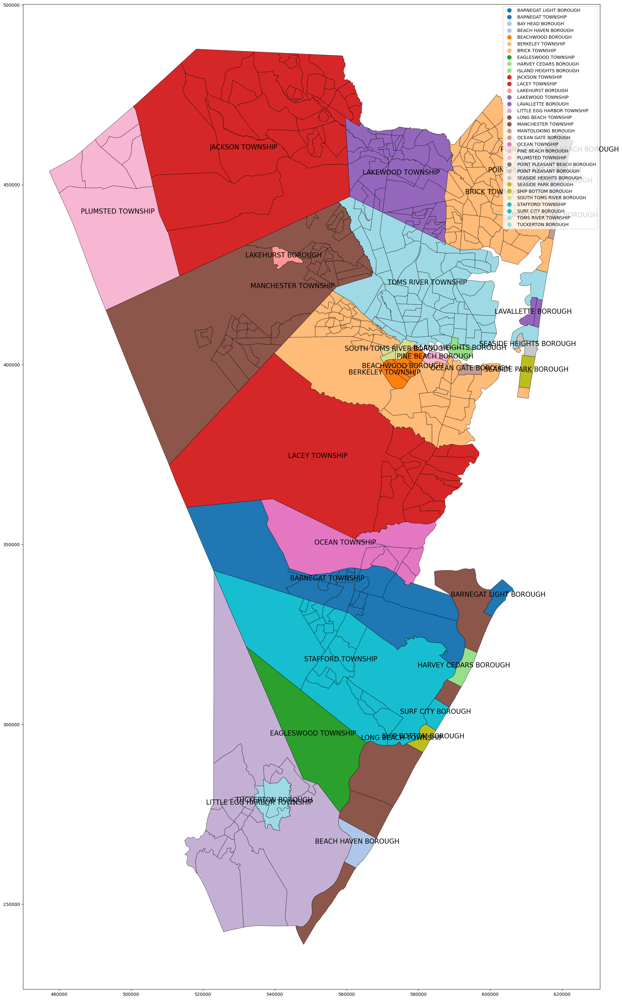

In [270]:

# Create the figure and axis
fig, ax = plt.subplots(figsize=(40, 40))

# Filter for the county of interest
gdf_ocean = gdf_2022[gdf_2022['COUNTY'] == 'OCEAN']

# Plot the geometries for the county with improved borders
gdf_ocean.plot(column='MUN_NAME', ax=ax, legend=True, cmap='tab20', edgecolor='black', linewidth=0.5)

# Clean geometries by applying buffer(0)
gdf_ocean['geometry'] = gdf_ocean['geometry'].buffer(0)

# Perform the dissolve operation
gdf_ocean = gdf_ocean.dissolve(by='MUN_NAME', as_index=False)

# Add labels to each precinct based on manual_mapping flag
for x, y, label in zip(gdf_ocean.geometry.centroid.x, gdf_ocean.geometry.centroid.y, gdf_ocean['MUN_NAME']):
    ax.text(x, y, label, fontsize=15, ha='center')  # Adjust font size as needed

# Show the plot
plt.show()


['BARNEGAT', 'BARNEGAT LIGHT', 'BAY HEAD', 'BEACH HAVEN', 'BEACHWOOD', 'BERKELEY', 'BRICK', 'EAGLESWOOD', 'HARVEY CEDARS', 'ISLAND HEIGHTS', 'JACKSON', 'LACEY', 'LAKEHURST', 'LAKEWOOD', 'LAVALLETTE', 'LITTLE EGG HARBOR', 'LONG BEACH', 'MANCHESTER', 'MANTOLOKING', 'OCEAN', 'OCEAN GATE', 'PINE BEACH', 'PLUMSTED', 'POINT PLEASANT', 'POINT PLEASANT BEACH', 'SEASIDE HEIGHTS', 'SEASIDE PARK', 'SHIP BOTTOM', 'SOUTH TOMS RIVER', 'STAFFORD', 'SURF CITY', 'TOMS RIVER', 'TUCKERTON']
['BARNEGAT', 'BARNEGAT LIGHT', 'BAY HEAD', 'BEACH HAVEN', 'BEACHWOOD', 'BERKELEY', 'BRICK', 'EAGLESWOOD', 'HARVEY CEDARS', 'ISLAND HEIGHTS', 'JACKSON', 'LACEY', 'LAKEHURST', 'LAKEWOOD', 'LAVALLETTE', 'LITTLE EGG HARBOR', 'LONG BEACH', 'MANCHESTER', 'MANTOLOKING', 'OCEAN', 'OCEAN GATE', 'PINE BEACH', 'PLUMSTED', 'POINT PLEASANT', 'POINT PLEASANT BEACH', 'SEASIDE HEIGHTS', 'SEASIDE PARK', 'SHIP BOTTOM', 'SOUTH TOMS RIVER', 'STAFFORD', 'SURF CITY', 'TOMS RIVER', 'TUCKERTON']


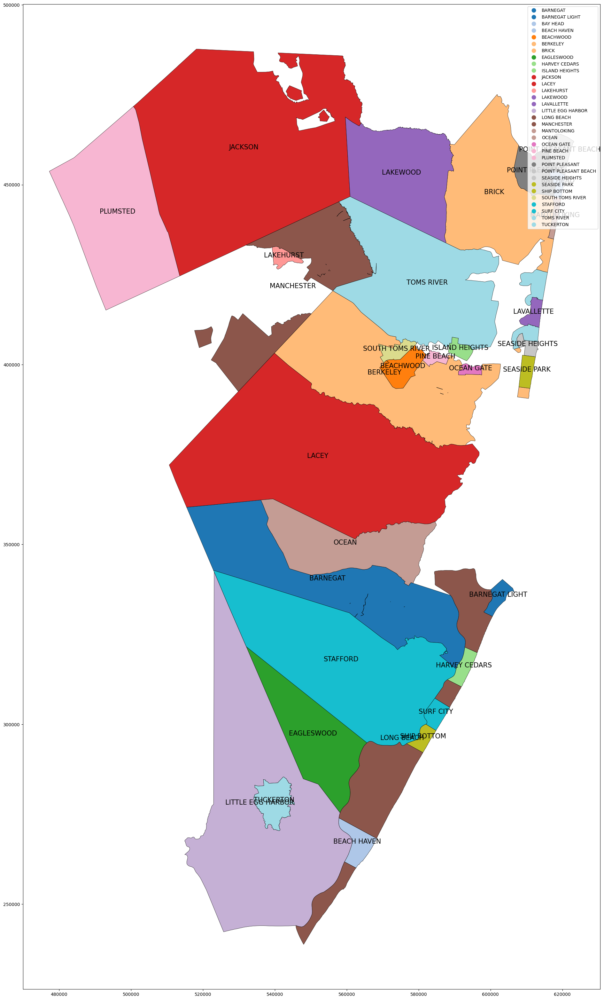

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,LAKEWOOD,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,21585,OCEAN,34029.0,OCEAN,34029.0,CHRISTOPHER H SMITH,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAKEWOOD,"POLYGON ((572638.451 464839.889, 572677.894 46..."
1,LAKEWOOD,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,2800,OCEAN,34029.0,OCEAN,34029.0,MATTHEW JENKINS,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAKEWOOD,"POLYGON ((572638.451 464839.889, 572677.894 46..."
2,LAKEWOOD,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,44,OCEAN,34029.0,OCEAN,34029.0,JASON CULLEN,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAKEWOOD,"POLYGON ((572638.451 464839.889, 572677.894 46..."
3,LAKEWOOD,US HOUSE,WE THE PEOPLE,OTHER,TOTAL,40,OCEAN,34029.0,OCEAN,34029.0,DAVID SCHMIDT,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAKEWOOD,"POLYGON ((572638.451 464839.889, 572677.894 46..."
4,LAKEWOOD,US HOUSE,NO SLOGAN FILED,OTHER,TOTAL,19,OCEAN,34029.0,OCEAN,34029.0,HANK SCHROEDER,4.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LAKEWOOD,"POLYGON ((572638.451 464839.889, 572677.894 46..."


In [274]:
ocean_processed = process_county('OCEAN', df, gdf_2022)
ocean_processed.head(5)

### PASSAIC COUNTY

['BLOOMINGDALE', 'CLIFTON', 'HALEDON', 'HAWTHORNE', 'LITTLE FALLS', 'NORTH HALEDON', 'PASSAIC', 'PATERSON', 'POMPTON LAKES', 'PROSPECT PARK', 'RINGWOOD', 'TOTOWA', 'WANAQUE', 'WAYNE', 'WEST MILFORD', 'WOODLAND PARK']
['BLOOMINGDALE', 'CLIFTON', 'HALEDON', 'HAWTHORNE', 'LITTLE FALLS', 'NORTH HALEDON', 'PASSAIC', 'PATERSON', 'POMPTON LAKES', 'PROSPECT PARK', 'RINGWOOD', 'TOTOWA', 'WANAQUE', 'WAYNE', 'WEST MILFORD', 'WOODLAND PARK']


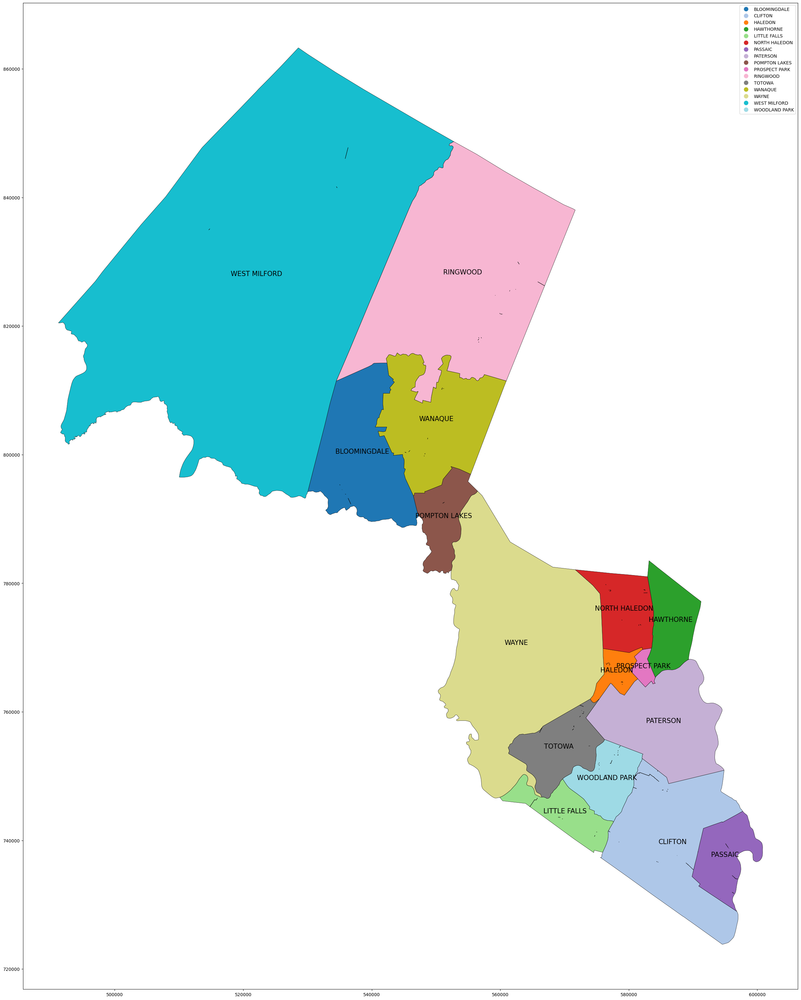

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,CLIFTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,10901,PASSAIC,34031.0,PASSAIC,34031.0,BILL PASCRELL JR,9.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLIFTON,"POLYGON ((586175.775 732204.087, 586201.235 73..."
1,CLIFTON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,7900,PASSAIC,34031.0,PASSAIC,34031.0,BILLY PREMPEH,9.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLIFTON,"POLYGON ((586175.775 732204.087, 586201.235 73..."
2,CLIFTON,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,153,PASSAIC,34031.0,PASSAIC,34031.0,SEAN ARMSTRONG,9.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLIFTON,"POLYGON ((586175.775 732204.087, 586201.235 73..."
3,CLIFTON,US HOUSE,SOCIALIST WORKERS,OTHER,TOTAL,175,PASSAIC,34031.0,PASSAIC,34031.0,LEA SHERMAN,9.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLIFTON,"POLYGON ((586175.775 732204.087, 586201.235 73..."
4,CLIFTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,10901,PASSAIC,34031.0,PASSAIC,34031.0,BILL PASCRELL JR,9.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,CLIFTON,"POLYGON ((587293.635 735339.693, 587260.283 73..."


In [254]:
passaic_processed = process_county('PASSAIC', df, gdf_2022)
passaic_processed.head(5)

### SALEM COUNTY

['ALLOWAY', 'CARNEYS POINT', 'ELMER', 'ELSINBORO', 'LOWER ALLOWAYS CREEK', 'MANNINGTON', 'OLDMANS', 'PENNS GROVE', 'PENNSVILLE', 'PILESGROVE', 'PITTSGROVE', 'QUINTON', 'SALEM', 'UPPER PITTSGROVE', 'WOODSTOWN']
['ALLOWAY', 'CARNEYS POINT', 'ELMER', 'ELSINBORO', 'LOWER ALLOWAYS CREEK', 'MANNINGTON', 'OLDMANS', 'PENNS GROVE', 'PENNSVILLE', 'PILESGROVE', 'PITTSGROVE', 'QUINTON', 'SALEM', 'UPPER PITTSGROVE', 'WOODSTOWN']


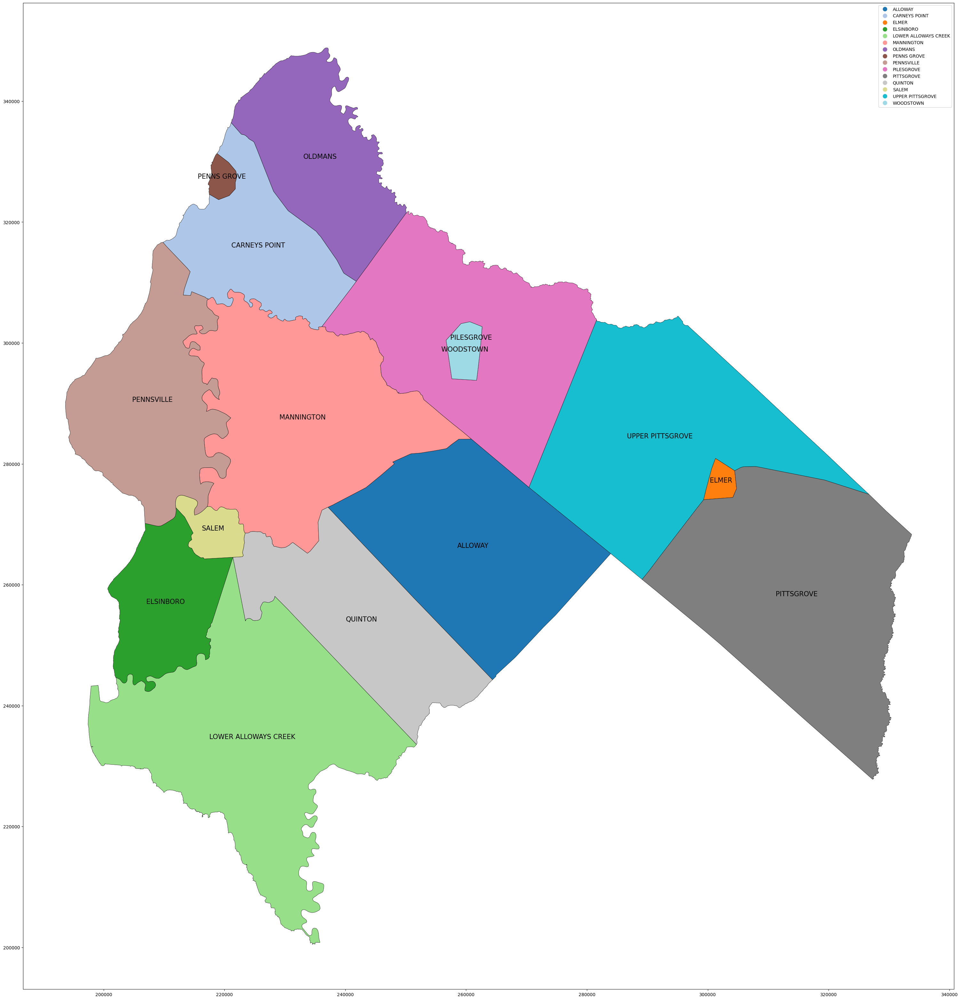

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,QUINTON,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,540,SALEM,34033.0,SALEM,34033.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,QUINTON,"POLYGON ((223055.737 265661.649, 223165.030 26..."
1,QUINTON,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,227,SALEM,34033.0,SALEM,34033.0,TIM ALEXANDER,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,QUINTON,"POLYGON ((223055.737 265661.649, 223165.030 26..."
2,QUINTON,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,10,SALEM,34033.0,SALEM,34033.0,MICHAEL GALLO,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,QUINTON,"POLYGON ((223055.737 265661.649, 223165.030 26..."
3,QUINTON,US HOUSE,NOT FOR SALE,OTHER,TOTAL,4,SALEM,34033.0,SALEM,34033.0,ANTHONY PARISI SANCHEZ,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,QUINTON,"POLYGON ((223055.737 265661.649, 223165.030 26..."
4,LOWER ALLOWAYS CREEK,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,585,SALEM,34033.0,SALEM,34033.0,JEFF VAN DREW,2.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,LOWER ALLOWAYS CREEK,"POLYGON ((223206.268 213829.326, 223266.771 21..."


In [255]:
salem_processed = process_county('SALEM', df, gdf_2022)
salem_processed.head(5)

### SOMERSET COUNTY

['BEDMINSTER', 'BERNARDS', 'BERNARDSVILLE', 'BOUND BROOK', 'BRANCHBURG', 'BRIDGEWATER', 'FAR HILLS', 'FRANKLIN', 'GREEN BROOK', 'HILLSBOROUGH', 'MANVILLE', 'MILLSTONE', 'MONTGOMERY', 'NORTH PLAINFIELD', 'PEAPACK-GLADSTONE', 'RARITAN', 'ROCKY HILL', 'SOMERVILLE', 'SOUTH BOUND BROOK', 'WARREN', 'WATCHUNG']
['BEDMINSTER', 'BERNARDS', 'BERNARDSVILLE', 'BOUND BROOK', 'BRANCHBURG', 'BRIDGEWATER', 'FAR HILLS', 'FRANKLIN', 'GREEN BROOK', 'HILLSBOROUGH', 'MANVILLE', 'MILLSTONE', 'MONTGOMERY', 'NORTH PLAINFIELD', 'PEAPACK-GLADSTONE', 'RARITAN', 'ROCKY HILL', 'SOMERVILLE', 'SOUTH BOUND BROOK', 'WARREN', 'WATCHUNG']


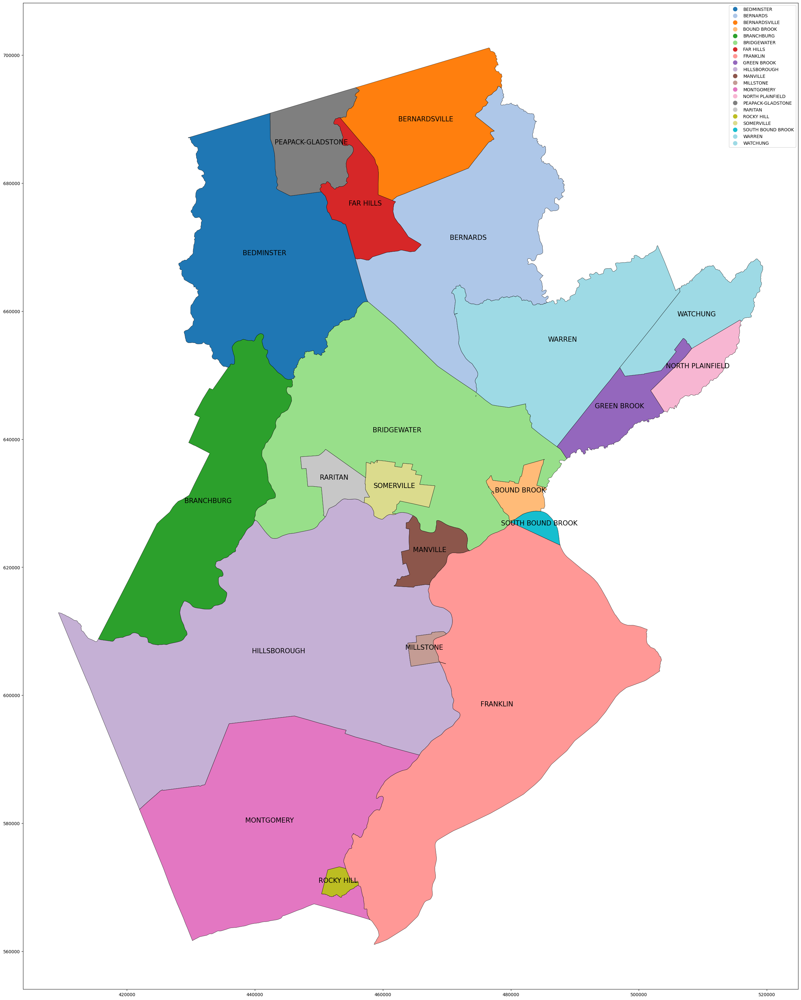

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,NORTH PLAINFIELD,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,2824,SOMERSET,34035.0,SOMERSET,34035.0,BONNIE WATSON COLEMAN,12.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NORTH PLAINFIELD,"POLYGON ((509989.451 651645.871, 509862.109 65..."
1,NORTH PLAINFIELD,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,1277,SOMERSET,34035.0,SOMERSET,34035.0,DARIUS MAYFIELD,12.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NORTH PLAINFIELD,"POLYGON ((509989.451 651645.871, 509862.109 65..."
2,NORTH PLAINFIELD,US HOUSE,LIBERTARIAN,LIBERTARIAN,TOTAL,39,SOMERSET,34035.0,SOMERSET,34035.0,C LYNN GENRICH,12.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NORTH PLAINFIELD,"POLYGON ((509989.451 651645.871, 509862.109 65..."
3,FRANKLIN,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,13959,SOMERSET,34035.0,SOMERSET,34035.0,BONNIE WATSON COLEMAN,12.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,FRANKLIN,"POLYGON ((457301.934 566584.426, 457288.130 56..."
4,FRANKLIN,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,5527,SOMERSET,34035.0,SOMERSET,34035.0,DARIUS MAYFIELD,12.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,FRANKLIN,"POLYGON ((457301.934 566584.426, 457288.130 56..."


In [256]:
somerset_processed = process_county('SOMERSET', df, gdf_2022)
somerset_processed.head(5)

### SUSSEX COUNTY

In [250]:
allocate_votes(df, 'SUSSEX', 'TOM MALINOWSKI', 14)
allocate_votes(df, 'SUSSEX', 'THOMAS H KEAN JR', 2)
allocate_votes(df, 'SUSSEX', 'JOSH GOTTHEIMER', 11)
allocate_votes(df, 'SUSSEX', 'FRANK T PALLOTTA', 4)

['ANDOVER', 'BRANCHVILLE', 'BYRAM', 'FRANKFORD', 'FRANKLIN', 'FREDON', 'GREEN', 'HAMBURG', 'HAMPTON', 'HARDYSTON', 'HOPATCONG', 'LAFAYETTE', 'MONTAGUE', 'NEWTON', 'OGDENSBURG', 'SANDYSTON', 'SPARTA', 'STANHOPE', 'STILLWATER', 'SUSSEX', 'VERNON', 'WALPACK', 'WANTAGE']
['ANDOVER', 'BRANCHVILLE', 'BYRAM', 'FRANKFORD', 'FRANKLIN', 'FREDON', 'GREEN', 'HAMBURG', 'HAMPTON', 'HARDYSTON', 'HOPATCONG', 'LAFAYETTE', 'MONTAGUE', 'NEWTON', 'OGDENSBURG', 'SANDYSTON', 'SPARTA', 'STANHOPE', 'STILLWATER', 'SUSSEX', 'VERNON', 'WALPACK', 'WANTAGE']


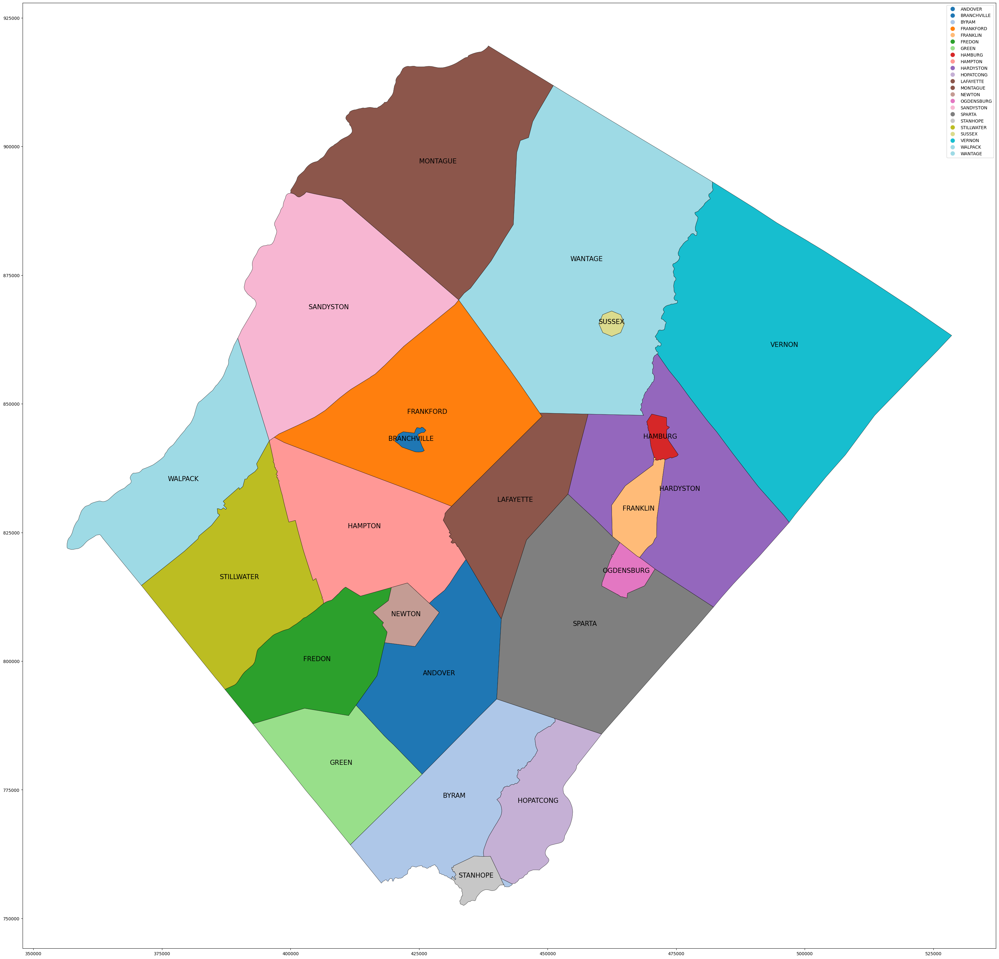

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,NEWTON,US HOUSE,DEMOCRAT,DEMOCRAT,NON-FEDERAL,1070,SUSSEX,34037.0,SUSSEX,34037.0,JOSH GOTTHEIMER,5.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NEWTON,"POLYGON ((423891.690 807046.723, 423912.757 80..."
1,NEWTON,US HOUSE,REPUBLICAN,REPUBLICAN,NON-FEDERAL,1083,SUSSEX,34037.0,SUSSEX,34037.0,FRANK T PALLOTTA,5.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NEWTON,"POLYGON ((423891.690 807046.723, 423912.757 80..."
2,NEWTON,US HOUSE,LIBERTARIAN PARTY,OTHER,NON-FEDERAL,18,SUSSEX,34037.0,SUSSEX,34037.0,JEREMY MARCUS,5.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NEWTON,"POLYGON ((423891.690 807046.723, 423912.757 80..."
3,NEWTON,US HOUSE,TOGETHER WE STAND,OTHER,NON-FEDERAL,13,SUSSEX,34037.0,SUSSEX,34037.0,TREVOR JAMES FERRIGNO,5.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NEWTON,"POLYGON ((423891.690 807046.723, 423912.757 80..."
4,NEWTON,US HOUSE,AMERICAN VALUES,OTHER,NON-FEDERAL,16,SUSSEX,34037.0,SUSSEX,34037.0,LOUIS VELLUCCI,5.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,NEWTON,"POLYGON ((423891.690 807046.723, 423912.757 80..."


In [251]:
sussex_processed = process_county('SUSSEX', df, gdf_2022)
sussex_processed.head(5)

### UNION COUNTY

['BERKELEY HEIGHTS', 'CLARK', 'CRANFORD', 'ELIZABETH', 'FANWOOD', 'GARWOOD', 'HILLSIDE', 'KENILWORTH', 'LINDEN', 'MOUNTAINSIDE', 'NEW PROVIDENCE', 'PLAINFIELD', 'RAHWAY', 'ROSELLE', 'ROSELLE PARK', 'SCOTCH PLAINS', 'SPRINGFIELD', 'SUMMIT', 'UNION', 'WESTFIELD', 'WINFIELD']
['BERKELEY HEIGHTS', 'CLARK', 'CRANFORD', 'ELIZABETH', 'FANWOOD', 'GARWOOD', 'HILLSIDE', 'KENILWORTH', 'LINDEN', 'MOUNTAINSIDE', 'NEW PROVIDENCE', 'PLAINFIELD', 'RAHWAY', 'ROSELLE', 'ROSELLE PARK', 'SCOTCH PLAINS', 'SPRINGFIELD', 'SUMMIT', 'UNION', 'WESTFIELD', 'WINFIELD']


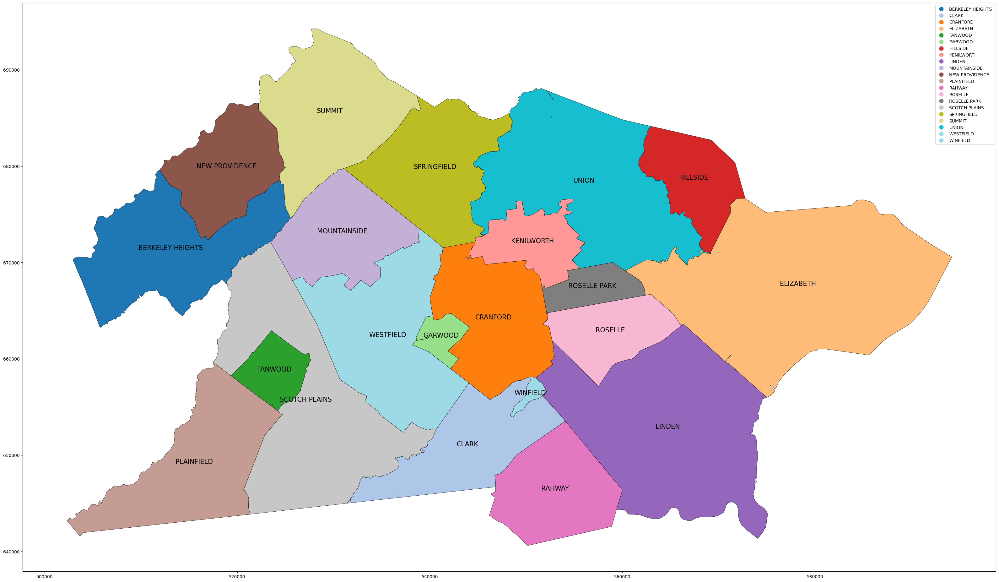

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,ROSELLE PARK,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,1943,UNION,34039.0,UNION,34039.0,DONALD M PAYNE JR,10.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,ROSELLE PARK,"POLYGON ((561075.452 668617.173, 561193.400 66..."
1,ROSELLE PARK,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,1475,UNION,34039.0,UNION,34039.0,DAVID H PINCKNEY,10.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,ROSELLE PARK,"POLYGON ((561075.452 668617.173, 561193.400 66..."
2,ROSELLE PARK,US HOUSE,THE MAHALI PARTY,OTHER,TOTAL,16,UNION,34039.0,UNION,34039.0,CLENARD HOWARD CHILDRESS JR,10.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,ROSELLE PARK,"POLYGON ((561075.452 668617.173, 561193.400 66..."
3,ROSELLE PARK,US HOUSE,JOBS AND JUSTICE,OTHER,TOTAL,32,UNION,34039.0,UNION,34039.0,CYNTHIA A JOHNSON,10.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,ROSELLE PARK,"POLYGON ((561075.452 668617.173, 561193.400 66..."
4,ROSELLE PARK,US HOUSE,LIBERTARIAN PARTY,OTHER,TOTAL,22,UNION,34039.0,UNION,34039.0,KENDAL LUDDEN,10.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,ROSELLE PARK,"POLYGON ((561075.452 668617.173, 561193.400 66..."


In [252]:
union_processed = process_county('UNION', df, gdf_2022)
union_processed.head(5)

### WARREN COUNTY

['ALLAMUCHY', 'ALPHA', 'BELVIDERE', 'BLAIRSTOWN', 'FRANKLIN', 'FRELINGHUYSEN', 'GREENWICH', 'HACKETTSTOWN', 'HARDWICK', 'HARMONY', 'HOPE', 'INDEPENDENCE', 'KNOWLTON', 'LIBERTY', 'LOPATCONG', 'MANSFIELD', 'OXFORD', 'PHILLIPSBURG', 'POHATCONG', 'WASHINGTON', 'WHITE']
['ALLAMUCHY', 'ALPHA', 'BELVIDERE', 'BLAIRSTOWN', 'FRANKLIN', 'FRELINGHUYSEN', 'GREENWICH', 'HACKETTSTOWN', 'HARDWICK', 'HARMONY', 'HOPE', 'INDEPENDENCE', 'KNOWLTON', 'LIBERTY', 'LOPATCONG', 'MANSFIELD', 'OXFORD', 'PHILLIPSBURG', 'POHATCONG', 'WASHINGTON', 'WHITE']


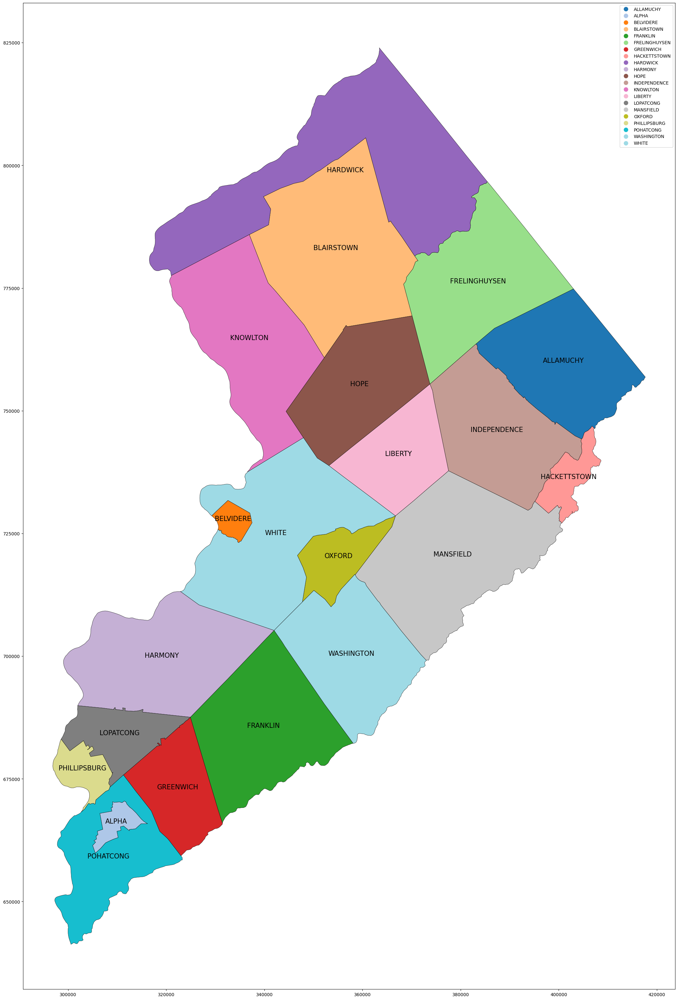

,precinct,office,party_detailed,party_simplified,mode,votes,county_name,county_fips,jurisdiction_name,jurisdiction_fips,candidate,district,dataverse,year,stage,state,special,writein,state_po,state_fips,state_cen,state_ic,date,readme_check,magnitude,precinct_mapped,geometry
0,POHATCONG,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,427,WARREN,34041.0,WARREN,34041.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,POHATCONG,"POLYGON ((301244.745 667486.335, 301273.644 66..."
1,POHATCONG,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,803,WARREN,34041.0,WARREN,34041.0,THOMAS H KEAN JR,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,POHATCONG,"POLYGON ((301244.745 667486.335, 301273.644 66..."
2,POHATCONG,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,427,WARREN,34041.0,WARREN,34041.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,POHATCONG,"POLYGON ((299792.999 651325.701, 299824.581 65..."
3,POHATCONG,US HOUSE,REPUBLICAN,REPUBLICAN,TOTAL,803,WARREN,34041.0,WARREN,34041.0,THOMAS H KEAN JR,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,POHATCONG,"POLYGON ((299792.999 651325.701, 299824.581 65..."
4,POHATCONG,US HOUSE,DEMOCRAT,DEMOCRAT,TOTAL,427,WARREN,34041.0,WARREN,34041.0,TOM MALINOWSKI,7.0,HOUSE,2022.0,GEN,NEW JERSEY,False,False,NJ,34.0,22.0,12.0,2022-11-08,True,1.0,POHATCONG,"POLYGON ((312849.774 673731.851, 312576.214 67..."


In [253]:
warren_processed = process_county('WARREN', df, gdf_2022)
warren_processed.head(5)

In [294]:
def combine_datasets(dfs):
    """
    Combine multiple datasets into a single DataFrame.
    
    Parameters:
    dfs (dict): Dictionary of DataFrames to combine, where the keys are county names and the values are DataFrames.
    
    Returns:
    pd.DataFrame: Combined DataFrame with all counties' data.
    """
    # Combine all DataFrames
    combined_df = pd.concat(dfs.values(), ignore_index=True)
    
    return combined_df

dfs = {
    'ATLANTIC': atlantic_processed,
    'BERGEN': bergen_processed,
    'BURLINGTON': burlington_processed,
    'CAMDEN': camden_processed,
    'CAPE MAY': cape_may_processed,
    'CUMBERLAND': cumberland_processed,
    'ESSEX': essex_processed,
    'GLOUCESTER': gloucester_processed,
    'HUDSON': hudson_processed,
    'HUNTERDON': hunterdon_processed,
    'MERCER': mercer_processed,
    'MIDDLESEX': middlesex_processed,
    'MONMOUTH': monmouth_processed,
    'MORRIS': morris_processed,
    'OCEAN': ocean_processed,
    'PASSAIC': passaic_processed,
    'SALEM': salem_processed,
    'SOMERSET': somerset_processed,
    'SUSSEX': sussex_processed,
    'UNION': union_processed,
    'WARREN': warren_processed
}

# Combine all datasets
combined_df = combine_datasets(dfs)

# Print the combined DataFrame
print(combined_df)

                       precinct        office           party_detailed  \
0                       MULLICA      US HOUSE               REPUBLICAN   
1                       MULLICA      US HOUSE                 DEMOCRAT   
2                       MULLICA      US HOUSE        LIBERTARIAN PARTY   
3                       MULLICA      US HOUSE             NOT FOR SALE   
4                   BUENA VISTA      US HOUSE               REPUBLICAN   
5                   BUENA VISTA      US HOUSE                 DEMOCRAT   
6                   BUENA VISTA      US HOUSE        LIBERTARIAN PARTY   
7                   BUENA VISTA      US HOUSE             NOT FOR SALE   
8                   BUENA VISTA      US HOUSE               REPUBLICAN   
9                   BUENA VISTA      US HOUSE                 DEMOCRAT   
10                  BUENA VISTA      US HOUSE        LIBERTARIAN PARTY   
11                  BUENA VISTA      US HOUSE             NOT FOR SALE   
12                  BUENA VISTA      U

In [296]:

office_mapping = {
    'US HOUSE': 'USH',
    'STATE HOUSE': 'STH',
    'STATE SENATE': 'STS'
}

# Function to create a unique column name
def create_column_name(row, existing_names):
    office_abbr = office_mapping.get(row['office'], '')
    party_initial = row['party_detailed'][0]
    last_name = row['candidate'].split()[-1][:3].upper()
    
    if pd.notna(row['district']):
        district = str(int(row['district']))  # Ensure district is not a float
        base_name = f"G{office_abbr}{district}{party_initial}{last_name}"
    else:
        base_name = f"G22{office_abbr}{party_initial}{last_name}"
    
    # Ensure the column name is unique
    if base_name not in existing_names:
        return base_name
    else:
        suffix = 1
        new_name = f"{base_name}_{suffix}"
        while new_name in existing_names:
            suffix += 1
            new_name = f"{base_name}_{suffix}"
        return new_name

def process_dataset(df):
    # Filter out rows where office is NaN
    df_cleaned = df.dropna(subset=['office'])
    
    # Track existing column names to ensure uniqueness
    existing_names = set()
    
    # Apply the function to create new column names
    df_cleaned['ColumnName'] = df_cleaned.apply(lambda row: create_column_name(row, existing_names), axis=1)
    
    # Update the set of existing names
    existing_names.update(df_cleaned['ColumnName'].tolist())
    
    # Aggregate votes for each candidate within the same precinct
    aggregated_df = df_cleaned.groupby(['county_name', 'precinct', 'ColumnName'])['votes'].sum().reset_index()
    
    # Pivot dataset
    pivoted_df = aggregated_df.pivot(
        index=['county_name', 'precinct'],
        columns='ColumnName',
        values='votes'
    )
    
    # Flatten the columns
    pivoted_df.columns = [col for col in pivoted_df.columns]
    
    # Reset index
    pivoted_df.reset_index(inplace=True)
    
    # Merge the geometry back into the pivoted DataFrame
    geom_df = df_cleaned[['county_name', 'precinct', 'geometry']].drop_duplicates()
    final_df = pd.merge(pivoted_df, geom_df, on=['county_name', 'precinct'], how='left')
    
    # Convert the final DataFrame back to a GeoDataFrame
    final_gdf = gpd.GeoDataFrame(final_df, geometry='geometry')

    return final_gdf

final_pber = process_dataset(combined_df)

final_pber.head(5)



,county_name,precinct,GSTH12DSAR,GSTH12RIII,GSTS28DBUR,GSTS28RFRE,GUSH10DJR,GUSH10JJOH,GUSH10LLUD,GUSH10RPIN,GUSH10TJR,GUSH11DSHE,GUSH11LBIA,GUSH11RDEG,GUSH12DCOL,GUSH12LGEN,GUSH12RMAY,GUSH1CCAN,GUSH1DNOR,GUSH1FKLI,GUSH1LFLE,GUSH1RGUS,GUSH2DALE,GUSH2LGAL,GUSH2NSAN,GUSH2RDRE,GUSH3DKIM,GUSH3GSOB,GUSH3LRUS,GUSH3RHEA,GUSH4DJEN,GUSH4LCUL,GUSH4NSCH,GUSH4PDAN,GUSH4RSMI,GUSH4WSCH,GUSH5AVEL,GUSH5DGOT,GUSH5LMAR,GUSH5RPAL,GUSH5TFER,GUSH6DJR,GUSH6LFIS,GUSH6MANT,GUSH6NSON,GUSH6RKIL,GUSH7DMAL,GUSH7RJR,GUSH8DMEN,GUSH8LDEL,GUSH8LOLI,GUSH8OCOO,GUSH8RARR,GUSH8SKUN,GUSH8TSAL,GUSH9DJR,GUSH9LARM,GUSH9RPRE,GUSH9SSHE,geometry
0,ATLANTIC,ABSECON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8406,126,48,11364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((489363.483 220656.882, 491212.325 21..."
1,ATLANTIC,ABSECON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8406,126,48,11364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((490365.412 217397.657, 490706.721 21..."
2,ATLANTIC,ABSECON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8406,126,48,11364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((495433.539 201242.240, 495411.146 20..."
3,ATLANTIC,ABSECON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8406,126,48,11364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((492097.642 223037.584, 492126.224 22..."
4,ATLANTIC,ABSECON,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8406,126,48,11364,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((495742.361 220123.330, 496503.450 21..."
